In [ ]:
# IMPORTANT: SOME KAGGLE DATA SOURCES ARE PRIVATE
# RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES.
import kagglehub
kagglehub.login()


In [ ]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

khadiza13_less_data_path = kagglehub.dataset_download('khadiza13/less-data')

print('Data source import complete.')


In [ ]:
import numpy as np
import pandas as pd

In [ ]:
import os
import pandas as pd
import numpy as np
from PIL import Image
from tqdm import tqdm
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
from transformers import AutoTokenizer, AutoModel
import timm
import matplotlib.pyplot as plt

In [ ]:
csv_path = "/kaggle/input/less-data/changed_ds/new_ds_small.csv"
img_dir = "/kaggle/input/less-data/changed_ds/img"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
label2idx = {
    "stereotype & objectification": 0,
    "violence or abuse": 1,
    "non-misogynistic": 2
}
idx2label = {v: k for k, v in label2idx.items()}


Epoch 1/20


  0%|          | 0/200 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Train Loss: 0.9954, Train Acc: 0.4422, Train F1: 0.3640
Val Loss: 0.8404, Val Acc: 0.6575, Val F1: 0.6446

Epoch 2/20


  0%|          | 0/200 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Train Loss: 0.7189, Train Acc: 0.6853, Train F1: 0.6588
Val Loss: 0.8025, Val Acc: 0.6800, Val F1: 0.6781

Epoch 3/20


  0%|          | 0/200 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Train Loss: 0.5051, Train Acc: 0.8066, Train F1: 0.7989
Val Loss: 0.7821, Val Acc: 0.7300, Val F1: 0.7283

Epoch 4/20


  0%|          | 0/200 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Train Loss: 0.3303, Train Acc: 0.9009, Train F1: 0.8994
Val Loss: 0.9126, Val Acc: 0.7075, Val F1: 0.7068

Epoch 5/20


  0%|          | 0/200 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Train Loss: 0.2213, Train Acc: 0.9497, Train F1: 0.9494
Val Loss: 1.0024, Val Acc: 0.7150, Val F1: 0.7150

Epoch 6/20


  0%|          | 0/200 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Train Loss: 0.1653, Train Acc: 0.9750, Train F1: 0.9750
Val Loss: 1.1756, Val Acc: 0.7125, Val F1: 0.7154

Epoch 7/20


  0%|          | 0/200 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Train Loss: 0.1120, Train Acc: 0.9891, Train F1: 0.9891
Val Loss: 1.4289, Val Acc: 0.7050, Val F1: 0.7072

Epoch 8/20


  0%|          | 0/200 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


Train Loss: 0.1047, Train Acc: 0.9928, Train F1: 0.9928
Val Loss: 1.3801, Val Acc: 0.6850, Val F1: 0.6874
Early stopping at epoch 8

Test Evaluation

Classification Report:
                              precision    recall  f1-score   support

stereotype & objectification       0.71      0.83      0.76       169
           violence or abuse       0.78      0.65      0.71        92
            non-misogynistic       0.82      0.74      0.77       140

                    accuracy                           0.76       401
                   macro avg       0.77      0.74      0.75       401
                weighted avg       0.76      0.76      0.75       401


Confusion Matrix:
[[140  12  17]
 [ 26  60   6]
 [ 32   5 103]]

Test Loss: 1.0266, Test Acc: 0.7556, Test F1: 0.7548


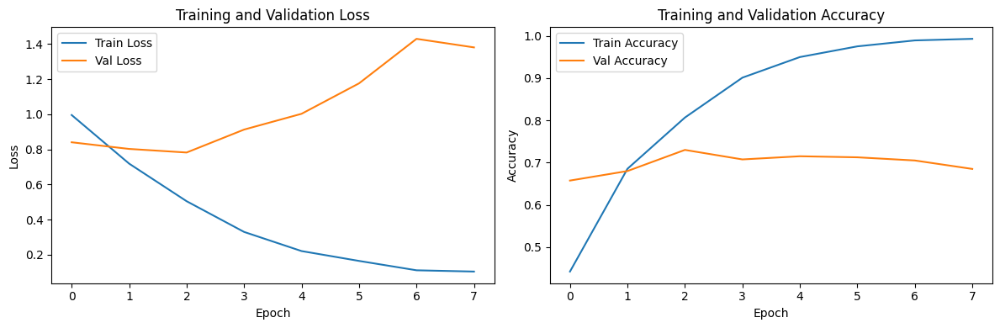

In [ ]:
from tqdm.notebook import tqdm, trange
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
import matplotlib.pyplot as plt
import numpy as np


# ======================= DATASET =========================
class MemeDataset(Dataset):
    def __init__(self, dataframe, img_dir, tokenizer, transform):
        self.data = dataframe
        self.img_dir = img_dir
        self.tokenizer = tokenizer
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        row = self.data.iloc[idx]
        image_path = os.path.join(self.img_dir, row["image"])
        image = self.transform(Image.open(image_path).convert("RGB"))
        text = row["text"]
        label = label2idx[row["label"]]

        encoding = self.tokenizer(text, padding="max_length", truncation=True, max_length=64, return_tensors="pt")
        return {
            "image": image,
            "input_ids": encoding["input_ids"].squeeze(0),
            "attention_mask": encoding["attention_mask"].squeeze(0),
            "label": torch.tensor(label)
        }

# ======================= IMPROVED MODEL =========================
class MultiModalModel(nn.Module):
    def __init__(self, text_model_name="csebuetnlp/banglabert", image_model_name="efficientnet_b0", num_classes=3):
        super().__init__()

        # Text Encoder (primary)
        self.text_encoder = AutoModel.from_pretrained(text_model_name)
        self.text_proj = nn.Linear(self.text_encoder.config.hidden_size, 256)

        # Image Encoder (secondary - reduced importance)
        self.image_encoder = timm.create_model(image_model_name, pretrained=True, num_classes=0)
        self.image_proj = nn.Linear(self.image_encoder.num_features, 128)  # Reduced from 256

        # First Fusion Layer (text + image embeddings)
        self.fusion = nn.Sequential(
            nn.Linear(256 + 128, 256),  # Text (256) + Image (128)
            nn.ReLU(),
            nn.Dropout(0.3)
        )

        # Multi-task heads
        self.text_head = nn.Linear(256, num_classes)
        self.image_head = nn.Linear(128, num_classes)  # Matches reduced image dim
        self.fusion_head = nn.Linear(256, num_classes)

        # Second Fusion Layer (combining logits from all heads)
        self.final_fusion = nn.Linear(num_classes * 3, num_classes)

    def forward(self, input_ids, attention_mask, image):
        # Text
        text_outputs = self.text_encoder(input_ids=input_ids, attention_mask=attention_mask)
        text_global = text_outputs.last_hidden_state[:, 0]  # [CLS] token
        text_embed = self.text_proj(text_global)

        # Image
        image_global = self.image_encoder(image)
        image_embed = self.image_proj(image_global)

        # First Fusion
        combined = torch.cat([text_embed, image_embed], dim=1)
        fused = self.fusion(combined)

        # Multi-task Heads
        text_logits = self.text_head(text_embed)
        image_logits = self.image_head(image_embed)
        fusion_logits = self.fusion_head(fused)

        # Second Fusion
        combined_logits = torch.cat([text_logits, image_logits, fusion_logits], dim=1)
        final_logits = self.final_fusion(combined_logits)

        return text_logits, image_logits, fusion_logits, final_logits

# ======================= EARLY STOPPING =========================
class EarlyStopping:
    def __init__(self, patience=5, min_delta=0.001, restore_best_weights=True):
        self.patience = patience
        self.min_delta = min_delta
        self.restore_best_weights = restore_best_weights
        self.best_loss = None
        self.counter = 0
        self.best_weights = None

    def __call__(self, val_loss, model):
        if self.best_loss is None:
            self.best_loss = val_loss
            self.save_checkpoint(model)
        elif val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
            self.save_checkpoint(model)
        else:
            self.counter += 1

        if self.counter >= self.patience:
            if self.restore_best_weights:
                model.load_state_dict(self.best_weights)
            return True
        return False

    def save_checkpoint(self, model):
        self.best_weights = model.state_dict().copy()

# ======================= TRAINING =========================
def train_epoch(model, dataloader, optimizer, criterion):
    model.train()
    total_loss = 0
    all_preds = []
    all_labels = []

    for batch in tqdm(dataloader):
        optimizer.zero_grad()
        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)
        image = batch["image"].to(device)
        label = batch["label"].to(device)

        text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, image)

        # Calculate losses for all heads
        loss_text = criterion(text_logits, label)
        loss_image = criterion(image_logits, label)
        loss_fusion = criterion(fusion_logits, label)
        loss_final = criterion(final_logits, label)

        # Weighted total loss - MORE WEIGHT ON TEXT
        loss = 0.5 * loss_text + 0.1 * loss_image + 0.2 * loss_fusion + 0.2 * loss_final
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

        # Get predictions from final logits
        pred = torch.argmax(final_logits, dim=1)
        all_preds.extend(pred.cpu().numpy())
        all_labels.extend(label.cpu().numpy())

    # Calculate metrics
    avg_loss = total_loss / len(dataloader)
    accuracy = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average='weighted')

    return avg_loss, accuracy, f1

# ======================= EVALUATION =========================
def evaluate(model, dataloader, criterion=None):
    model.eval()
    preds, labels = [], []
    total_loss = 0

    with torch.no_grad():
        for batch in dataloader:
            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)
            image = batch["image"].to(device)
            label = batch["label"].to(device)

            text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, image)

            if criterion is not None:
                loss_text = criterion(text_logits, label)
                loss_image = criterion(image_logits, label)
                loss_fusion = criterion(fusion_logits, label)
                loss_final = criterion(final_logits, label)
                loss = 0.5 * loss_text + 0.1 * loss_image + 0.2 * loss_fusion + 0.2 * loss_final
                total_loss += loss.item()

            # Get predictions from final logits
            pred = torch.argmax(final_logits, dim=1)
            preds.extend(pred.cpu().numpy())
            labels.extend(label.cpu().numpy())

    # Calculate metrics
    accuracy = accuracy_score(labels, preds)
    f1 = f1_score(labels, preds, average='weighted')
    avg_loss = total_loss / len(dataloader) if criterion is not None else None

    return preds, labels, avg_loss, accuracy, f1

# ======================= PREP =========================

df = pd.read_csv(csv_path)
df = df.rename(columns={"Unnamed: 0": "image"})

tokenizer = AutoTokenizer.from_pretrained("csebuetnlp/banglabert")
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # ImageNet normalization
])

dataset = MemeDataset(df, img_dir, tokenizer, transform)

# Split dataset
train_size = int(0.8 * len(dataset))
val_size = int(0.1 * len(dataset))
test_size = len(dataset) - train_size - val_size
train_ds, val_ds, test_ds = random_split(dataset, [train_size, val_size, test_size])

train_loader = DataLoader(train_ds, batch_size=16, shuffle=True)
val_loader = DataLoader(val_ds, batch_size=16)
test_loader = DataLoader(test_ds, batch_size=16)

# Model, optimizer, and loss
model = MultiModalModel().to(device)
optimizer = torch.optim.AdamW(model.parameters(), lr=2e-5, weight_decay=0.01)
criterion = nn.CrossEntropyLoss()

# Early stopping
early_stopping = EarlyStopping(patience=5, min_delta=0.001)

# ======================= METRICS TRACKING =========================
train_losses = []
train_accuracies = []
train_f1_scores = []
val_losses = []
val_accuracies = []
val_f1_scores = []

# ======================= TRAIN LOOP =========================
max_epochs = 20
for epoch in range(max_epochs):
    print(f"\nEpoch {epoch+1}/{max_epochs}")

    # Training
    train_loss, train_acc, train_f1 = train_epoch(model, train_loader, optimizer, criterion)
    train_losses.append(train_loss)
    train_accuracies.append(train_acc)
    train_f1_scores.append(train_f1)

    # Validation
    _, _, val_loss, val_acc, val_f1 = evaluate(model, val_loader, criterion)
    val_losses.append(val_loss)
    val_accuracies.append(val_acc)
    val_f1_scores.append(val_f1)

    print(f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, Train F1: {train_f1:.4f}")
    print(f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}, Val F1: {val_f1:.4f}")

    # Early stopping check
    if early_stopping(val_loss, model):
        print(f"Early stopping at epoch {epoch+1}")
        break

# ======================= TEST EVALUATION =========================
print("\nTest Evaluation")
test_preds, test_labels, test_loss, test_acc, test_f1 = evaluate(model, test_loader, criterion)

# Classification Report
print("\nClassification Report:")
print(classification_report(test_labels, test_preds, target_names=[idx2label[i] for i in range(len(label2idx))]))

# Confusion Matrix
print("\nConfusion Matrix:")
cm = confusion_matrix(test_labels, test_preds)
print(cm)

print(f"\nTest Loss: {test_loss:.4f}, Test Acc: {test_acc:.4f}, Test F1: {test_f1:.4f}")

# ======================= PLOT TRAINING HISTORY =========================
plt.figure(figsize=(12, 4))

plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(train_accuracies, label='Train Accuracy')
plt.plot(val_accuracies, label='Val Accuracy')
plt.title('Training and Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

Finding misclassified samples...
MISCLASSIFIED SAMPLES ANALYSIS
Total misclassified samples: 15
Average confidence: 0.483
Confidence range: 0.374 - 0.542

Confusion Patterns:
  non-misogynistic -> stereotype & objectification: 7 samples
  non-misogynistic -> violence or abuse: 2 samples
  stereotype & objectification -> violence or abuse: 2 samples
  violence or abuse -> non-misogynistic: 1 samples
  violence or abuse -> stereotype & objectification: 3 samples

Text Length Analysis:
  Average text length: 88.9 characters
  Text length range: 15 - 176

Most Uncertain Predictions (lowest confidence):
  violence or abuse -> non-misogynistic (conf: 0.374)
    Text: এটা কি আমার ভুল? 
না। এটা আমার আখেও হয়েছে! 
কিন্তু আমার সাথে কেন?...

  violence or abuse -> stereotype & objectification (conf: 0.396)
    Text: ঠিকই তো আছে। বইমেলা বই বিক্রির জন্য। ওখানে কেন এসব বিক্রি হবে
হঠাৎ করে আপনার পি...

  non-misogynistic -> stereotype & objectification (conf: 0.409)
    Text: ঘখন আপনি প্রপোজ করেন তুমি

/tmp/ipykernel_35/1825604365.py:113: UserWarning: Glyph 2447 (\N{BENGALI LETTER E}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_35/1825604365.py:113: UserWarning: Matplotlib currently does not support Bengali natively.
  plt.tight_layout()
/tmp/ipykernel_35/1825604365.py:113: UserWarning: Glyph 2463 (\N{BENGALI LETTER TTA}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_35/1825604365.py:113: UserWarning: Glyph 2494 (\N{BENGALI VOWEL SIGN AA}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_35/1825604365.py:113: UserWarning: Glyph 2453 (\N{BENGALI LETTER KA}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_35/1825604365.py:113: UserWarning: Glyph 2495 (\N{BENGALI VOWEL SIGN I}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_35/1825604365.py:113: UserWarning: Glyph 2438 (\N{BENGALI LETTER AA}) missing from current font.
  plt.tight_layout()
/tmp/ipykernel_35/1825604365.py:113: UserWarning: Glyph 2478 (\N{BEN

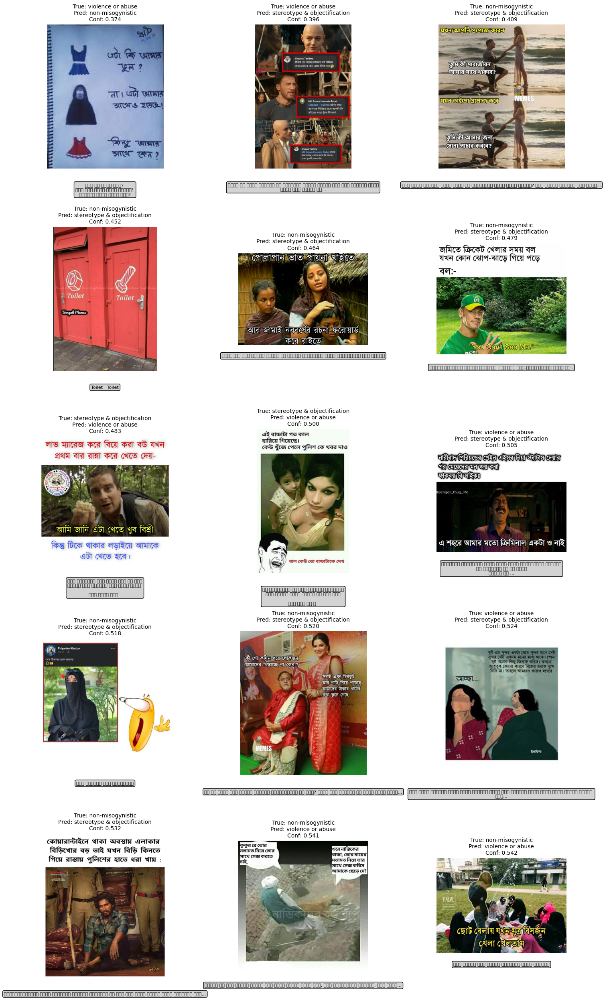


Detailed analysis of most uncertain sample:
DETAILED ANALYSIS - Sample 56
Text: এটা কি আমার ভুল? 
না। এটা আমার আখেও হয়েছে! 
কিন্তু আমার সাথে কেন?
Image: 1000.jpg
True Label: violence or abuse

Predictions by each head:
  stereotype & objectification:
    Text Head: 0.009
    Image Head: 0.462
    Fusion Head: 0.081
    Final: 0.281

  violence or abuse:
    Text Head: 0.292
    Image Head: 0.436
    Fusion Head: 0.248
    Final: 0.344

  non-misogynistic:
    Text Head: 0.700
    Image Head: 0.102
    Fusion Head: 0.672
    Final: 0.374



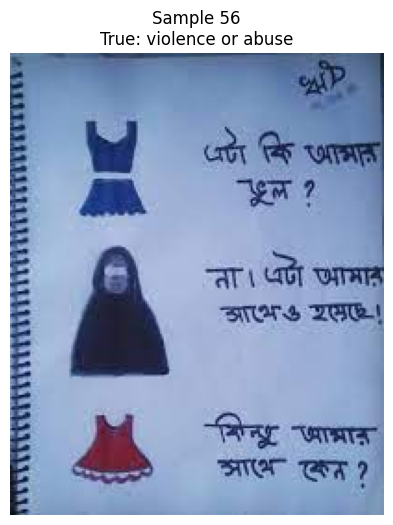

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
import torch
import os

# ======================= FIND MISCLASSIFIED SAMPLES =========================
def find_misclassified_samples(model, test_loader, dataset, num_samples=10):
    """
    Find misclassified samples from the test set
    """
    model.eval()
    misclassified = []

    with torch.no_grad():
        batch_idx = 0
        for batch in test_loader:
            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)
            image = batch["image"].to(device)
            labels = batch["label"].to(device)

            # Get predictions
            text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, image)
            predictions = torch.argmax(final_logits, dim=1)

            # Get probabilities for confidence scores
            probs = torch.softmax(final_logits, dim=1)
            confidence_scores = torch.max(probs, dim=1)[0]

            # Find misclassified samples in this batch
            for i in range(len(predictions)):
                if predictions[i] != labels[i]:
                    # Calculate actual index in original dataset
                    actual_idx = batch_idx * test_loader.batch_size + i

                    # Get original data
                    original_data = dataset.data.iloc[test_loader.dataset.indices[actual_idx]]

                    misclassified.append({
                        'index': actual_idx,
                        'image_path': original_data['image'],
                        'text': original_data['text'],
                        'true_label': idx2label[labels[i].item()],
                        'predicted_label': idx2label[predictions[i].item()],
                        'confidence': confidence_scores[i].item(),
                        'true_label_idx': labels[i].item(),
                        'predicted_label_idx': predictions[i].item()
                    })

            batch_idx += 1

    # Sort by confidence (lowest first - most uncertain predictions)
    misclassified.sort(key=lambda x: x['confidence'])

    return misclassified[:num_samples]

# ======================= VISUALIZE MISCLASSIFIED SAMPLES =========================
def visualize_misclassified(misclassified_samples, img_dir, max_text_length=100):
    """
    Visualize misclassified samples with images and text
    """
    n_samples = len(misclassified_samples)
    cols = 3
    rows = (n_samples + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(15, 5*rows))
    if rows == 1:
        axes = axes.reshape(1, -1)

    for i, sample in enumerate(misclassified_samples):
        row = i // cols
        col = i % cols

        if rows == 1:
            ax = axes[col]
        else:
            ax = axes[row, col]

        # Load and display image
        img_path = os.path.join(img_dir, sample['image_path'])
        try:
            img = Image.open(img_path).convert('RGB')
            ax.imshow(img)
        except:
            ax.text(0.5, 0.5, 'Image not found', ha='center', va='center', transform=ax.transAxes)

        # Truncate text if too long
        text = sample['text']
        if len(text) > max_text_length:
            text = text[:max_text_length] + "..."

        # Set title with prediction info
        title = f"True: {sample['true_label']}\nPred: {sample['predicted_label']}\nConf: {sample['confidence']:.3f}"
        ax.set_title(title, fontsize=10)

        # Add text below image
        ax.text(0.5, -0.1, text, ha='center', va='top', transform=ax.transAxes,
                fontsize=8, wrap=True, bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgray"))

        ax.axis('off')

    # Hide empty subplots
    for i in range(n_samples, rows * cols):
        row = i // cols
        col = i % cols
        if rows == 1:
            axes[col].axis('off')
        else:
            axes[row, col].axis('off')

    plt.tight_layout()
    plt.show()

# ======================= ANALYZE MISCLASSIFIED PATTERNS =========================
def analyze_misclassified_patterns(misclassified_samples):
    """
    Analyze patterns in misclassified samples
    """
    print("=" * 50)
    print("MISCLASSIFIED SAMPLES ANALYSIS")
    print("=" * 50)

    # Convert to DataFrame for easier analysis
    df = pd.DataFrame(misclassified_samples)

    print(f"Total misclassified samples: {len(df)}")
    print(f"Average confidence: {df['confidence'].mean():.3f}")
    print(f"Confidence range: {df['confidence'].min():.3f} - {df['confidence'].max():.3f}")

    # Confusion patterns
    print("\nConfusion Patterns:")
    confusion_counts = df.groupby(['true_label', 'predicted_label']).size()
    for (true_label, pred_label), count in confusion_counts.items():
        print(f"  {true_label} -> {pred_label}: {count} samples")

    # Text length analysis
    df['text_length'] = df['text'].str.len()
    print(f"\nText Length Analysis:")
    print(f"  Average text length: {df['text_length'].mean():.1f} characters")
    print(f"  Text length range: {df['text_length'].min()} - {df['text_length'].max()}")

    # Show most uncertain predictions
    print("\nMost Uncertain Predictions (lowest confidence):")
    for i, row in df.head(5).iterrows():
        print(f"  {row['true_label']} -> {row['predicted_label']} (conf: {row['confidence']:.3f})")
        print(f"    Text: {row['text'][:80]}...")
        print()

# ======================= DETAILED SAMPLE ANALYSIS =========================
def analyze_individual_sample(model, sample_idx, test_loader, dataset, img_dir):
    """
    Detailed analysis of a specific misclassified sample
    """
    model.eval()

    # Find the sample in test_loader
    found = False
    with torch.no_grad():
        batch_idx = 0
        for batch in test_loader:
            batch_size = len(batch["label"])
            start_idx = batch_idx * test_loader.batch_size
            end_idx = start_idx + batch_size

            if start_idx <= sample_idx < end_idx:
                # Found the batch containing our sample
                local_idx = sample_idx - start_idx

                input_ids = batch["input_ids"].to(device)
                attention_mask = batch["attention_mask"].to(device)
                image = batch["image"].to(device)
                labels = batch["label"].to(device)

                # Get detailed predictions
                text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, image)

                # Extract data for our specific sample
                sample_text_logits = text_logits[local_idx]
                sample_image_logits = image_logits[local_idx]
                sample_fusion_logits = fusion_logits[local_idx]
                sample_final_logits = final_logits[local_idx]

                # Get probabilities
                text_probs = torch.softmax(sample_text_logits, dim=0)
                image_probs = torch.softmax(sample_image_logits, dim=0)
                fusion_probs = torch.softmax(sample_fusion_logits, dim=0)
                final_probs = torch.softmax(sample_final_logits, dim=0)

                # Get original data
                original_data = dataset.data.iloc[test_loader.dataset.indices[sample_idx]]

                print("=" * 60)
                print(f"DETAILED ANALYSIS - Sample {sample_idx}")
                print("=" * 60)
                print(f"Text: {original_data['text']}")
                print(f"Image: {original_data['image']}")
                print(f"True Label: {idx2label[labels[local_idx].item()]}")
                print()

                print("Predictions by each head:")
                for i, label in enumerate([idx2label[j] for j in range(len(idx2label))]):
                    print(f"  {label}:")
                    print(f"    Text Head: {text_probs[i]:.3f}")
                    print(f"    Image Head: {image_probs[i]:.3f}")
                    print(f"    Fusion Head: {fusion_probs[i]:.3f}")
                    print(f"    Final: {final_probs[i]:.3f}")
                    print()

                # Show image
                img_path = os.path.join(img_dir, original_data['image'])
                try:
                    img = Image.open(img_path).convert('RGB')
                    plt.figure(figsize=(8, 6))
                    plt.imshow(img)
                    plt.title(f"Sample {sample_idx}\nTrue: {idx2label[labels[local_idx].item()]}")
                    plt.axis('off')
                    plt.show()
                except:
                    print("Could not load image")

                found = True
                break

            batch_idx += 1

    if not found:
        print(f"Sample {sample_idx} not found in test set")

# ======================= USAGE EXAMPLE =========================
def run_misclassified_analysis():
    """
    Complete workflow to analyze misclassified samples
    """
    print("Finding misclassified samples...")

    # Find misclassified samples
    misclassified = find_misclassified_samples(model, test_loader, dataset, num_samples=15)

    # Analyze patterns
    analyze_misclassified_patterns(misclassified)

    # Visualize samples
    print("\nVisualizing misclassified samples...")
    visualize_misclassified(misclassified, img_dir, max_text_length=80)

    # Detailed analysis of most uncertain sample
    if misclassified:
        print("\nDetailed analysis of most uncertain sample:")
        most_uncertain_idx = misclassified[0]['index']
        analyze_individual_sample(model, most_uncertain_idx, test_loader, dataset, img_dir)

    return misclassified

# ======================= RUN ANALYSIS =========================
# Uncomment the line below to run the analysis
misclassified_samples = run_misclassified_analysis()

Finding misclassified samples...
MISCLASSIFIED SAMPLES ANALYSIS
Total misclassified samples: 15
Average confidence: 0.693
Confidence range: 0.383 - 0.986

Confusion Patterns:
  non-misogynistic -> stereotype & objectification: 3 samples
  non-misogynistic -> violence or abuse: 1 samples
  stereotype & objectification -> non-misogynistic: 2 samples
  stereotype & objectification -> violence or abuse: 5 samples
  violence or abuse -> non-misogynistic: 1 samples
  violence or abuse -> stereotype & objectification: 3 samples

Text Length Analysis:
  Average text length: 104.9 characters
  Text length range: 33 - 176

Most Uncertain Predictions (lowest confidence):
  non-misogynistic -> stereotype & objectification (conf: 0.887)
    Text: সৌন্দর্য আমাদের অধিকার 
আর রান্নাঘর সামলানো আমাদের কর্তব্য...

  non-misogynistic -> violence or abuse (conf: 0.541)
    Text: কুকুর রে তোর মতামত নিয়ে তোর সাথে সেক্স করতে চাই, ওরে নাস্তিকের বাচ্চা, তোর মায়ে...

  stereotype & objectification -> violence o

Glyph 2488 (\N{BENGALI LETTER SA}) missing from current font.
Matplotlib currently does not support Bengali natively.
Glyph 2508 (\N{BENGALI VOWEL SIGN AU}) missing from current font.
Glyph 2472 (\N{BENGALI LETTER NA}) missing from current font.
Glyph 2509 (\N{BENGALI SIGN VIRAMA}) missing from current font.
Glyph 2470 (\N{BENGALI LETTER DA}) missing from current font.
Glyph 2480 (\N{BENGALI LETTER RA}) missing from current font.
Glyph 2479 (\N{BENGALI LETTER YA}) missing from current font.
Glyph 2438 (\N{BENGALI LETTER AA}) missing from current font.
Glyph 2478 (\N{BENGALI LETTER MA}) missing from current font.
Glyph 2494 (\N{BENGALI VOWEL SIGN AA}) missing from current font.
Glyph 2503 (\N{BENGALI VOWEL SIGN E}) missing from current font.
Glyph 2437 (\N{BENGALI LETTER A}) missing from current font.
Glyph 2471 (\N{BENGALI LETTER DHA}) missing from current font.
Glyph 2495 (\N{BENGALI VOWEL SIGN I}) missing from current font.
Glyph 2453 (\N{BENGALI LETTER KA}) missing from current font

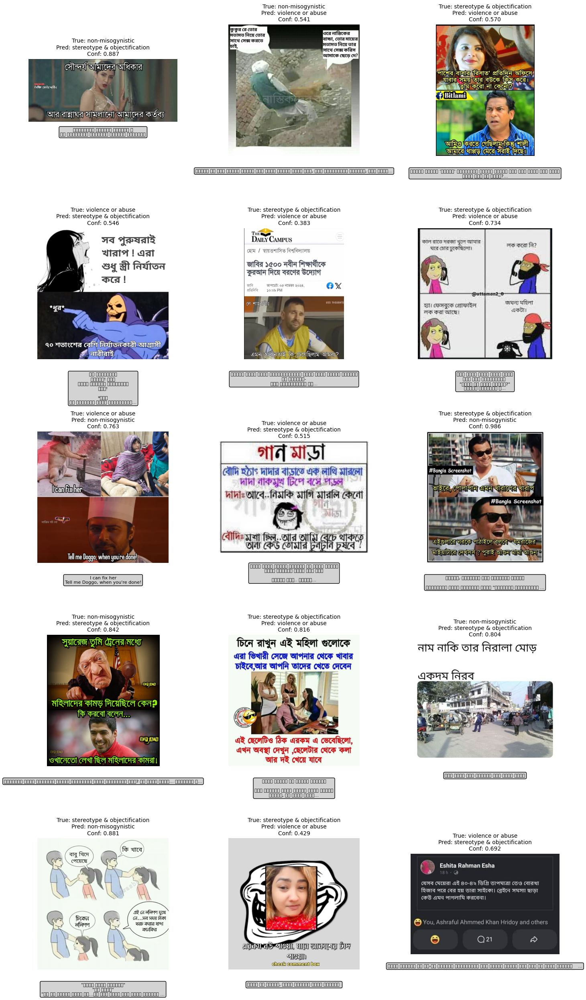


Detailed analysis of most uncertain sample:
DETAILED ANALYSIS - Sample 5
Text: সৌন্দর্য আমাদের অধিকার 
আর রান্নাঘর সামলানো আমাদের কর্তব্য
Image: 517.jpg
True Label: non-misogynistic

Predictions by each head:
  stereotype & objectification:
    Text Head: 0.998
    Image Head: 0.544
    Fusion Head: 0.998
    Final: 0.887

  violence or abuse:
    Text Head: 0.001
    Image Head: 0.052
    Fusion Head: 0.001
    Final: 0.089

  non-misogynistic:
    Text Head: 0.001
    Image Head: 0.405
    Fusion Head: 0.001
    Final: 0.024



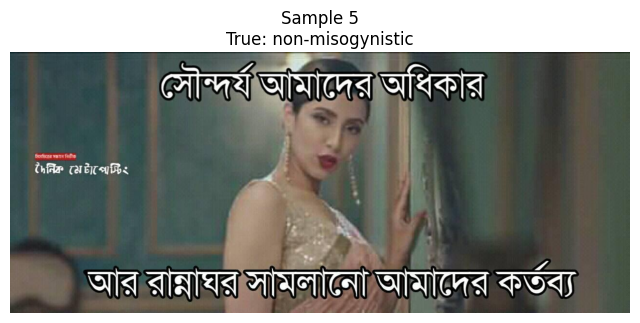

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from PIL import Image
import torch
import os

# ======================= FIND MISCLASSIFIED SAMPLES =========================
def find_misclassified_samples(model, test_loader, dataset, num_samples=10):
    """
    Find misclassified samples from the test set
    """
    model.eval()
    misclassified = []

    with torch.no_grad():
        batch_idx = 0
        for batch in test_loader:
            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)
            image = batch["image"].to(device)
            labels = batch["label"].to(device)

            # Get predictions
            text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, image)
            predictions = torch.argmax(final_logits, dim=1)

            # Get probabilities for confidence scores
            probs = torch.softmax(final_logits, dim=1)
            confidence_scores = torch.max(probs, dim=1)[0]

            # Find misclassified samples in this batch
            for i in range(len(predictions)):
                if predictions[i] != labels[i]:
                    # Stop if we have enough samples
                    if len(misclassified) >= num_samples:
                        return misclassified

                    # Calculate actual index in original dataset
                    actual_idx = batch_idx * test_loader.batch_size + i

                    # Get original data
                    original_data = dataset.data.iloc[test_loader.dataset.indices[actual_idx]]

                    misclassified.append({
                        'index': actual_idx,
                        'image_path': original_data['image'],
                        'text': original_data['text'],
                        'true_label': idx2label[labels[i].item()],
                        'predicted_label': idx2label[predictions[i].item()],
                        'confidence': confidence_scores[i].item(),
                        'true_label_idx': labels[i].item(),
                        'predicted_label_idx': predictions[i].item()
                    })

            batch_idx += 1

    # Remove this sorting line to get first 15 in dataset order
    # misclassified.sort(key=lambda x: x['confidence'])

    return misclassified[:num_samples]

# ======================= VISUALIZE MISCLASSIFIED SAMPLES =========================
def visualize_misclassified(misclassified_samples, img_dir, max_text_length=100):
    """
    Visualize misclassified samples with images and text
    """
    n_samples = len(misclassified_samples)
    cols = 3
    rows = (n_samples + cols - 1) // cols

    fig, axes = plt.subplots(rows, cols, figsize=(15, 5*rows))
    if rows == 1:
        axes = axes.reshape(1, -1)

    for i, sample in enumerate(misclassified_samples):
        row = i // cols
        col = i % cols

        if rows == 1:
            ax = axes[col]
        else:
            ax = axes[row, col]

        # Load and display image
        img_path = os.path.join(img_dir, sample['image_path'])
        try:
            img = Image.open(img_path).convert('RGB')
            ax.imshow(img)
        except:
            ax.text(0.5, 0.5, 'Image not found', ha='center', va='center', transform=ax.transAxes)

        # Truncate text if too long
        text = sample['text']
        if len(text) > max_text_length:
            text = text[:max_text_length] + "..."

        # Set title with prediction info
        title = f"True: {sample['true_label']}\nPred: {sample['predicted_label']}\nConf: {sample['confidence']:.3f}"
        ax.set_title(title, fontsize=10)

        # Add text below image
        ax.text(0.5, -0.1, text, ha='center', va='top', transform=ax.transAxes,
                fontsize=8, wrap=True, bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgray"))

        ax.axis('off')

    # Hide empty subplots
    for i in range(n_samples, rows * cols):
        row = i // cols
        col = i % cols
        if rows == 1:
            axes[col].axis('off')
        else:
            axes[row, col].axis('off')

    plt.tight_layout()
    plt.show()

# ======================= ANALYZE MISCLASSIFIED PATTERNS =========================
def analyze_misclassified_patterns(misclassified_samples):
    """
    Analyze patterns in misclassified samples
    """
    print("=" * 50)
    print("MISCLASSIFIED SAMPLES ANALYSIS")
    print("=" * 50)

    # Convert to DataFrame for easier analysis
    df = pd.DataFrame(misclassified_samples)

    print(f"Total misclassified samples: {len(df)}")
    print(f"Average confidence: {df['confidence'].mean():.3f}")
    print(f"Confidence range: {df['confidence'].min():.3f} - {df['confidence'].max():.3f}")

    # Confusion patterns
    print("\nConfusion Patterns:")
    confusion_counts = df.groupby(['true_label', 'predicted_label']).size()
    for (true_label, pred_label), count in confusion_counts.items():
        print(f"  {true_label} -> {pred_label}: {count} samples")

    # Text length analysis
    df['text_length'] = df['text'].str.len()
    print(f"\nText Length Analysis:")
    print(f"  Average text length: {df['text_length'].mean():.1f} characters")
    print(f"  Text length range: {df['text_length'].min()} - {df['text_length'].max()}")

    # Show most uncertain predictions
    print("\nMost Uncertain Predictions (lowest confidence):")
    for i, row in df.head(5).iterrows():
        print(f"  {row['true_label']} -> {row['predicted_label']} (conf: {row['confidence']:.3f})")
        print(f"    Text: {row['text'][:80]}...")
        print()

# ======================= DETAILED SAMPLE ANALYSIS =========================
def analyze_individual_sample(model, sample_idx, test_loader, dataset, img_dir):
    """
    Detailed analysis of a specific misclassified sample
    """
    model.eval()

    # Find the sample in test_loader
    found = False
    with torch.no_grad():
        batch_idx = 0
        for batch in test_loader:
            batch_size = len(batch["label"])
            start_idx = batch_idx * test_loader.batch_size
            end_idx = start_idx + batch_size

            if start_idx <= sample_idx < end_idx:
                # Found the batch containing our sample
                local_idx = sample_idx - start_idx

                input_ids = batch["input_ids"].to(device)
                attention_mask = batch["attention_mask"].to(device)
                image = batch["image"].to(device)
                labels = batch["label"].to(device)

                # Get detailed predictions
                text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, image)

                # Extract data for our specific sample
                sample_text_logits = text_logits[local_idx]
                sample_image_logits = image_logits[local_idx]
                sample_fusion_logits = fusion_logits[local_idx]
                sample_final_logits = final_logits[local_idx]

                # Get probabilities
                text_probs = torch.softmax(sample_text_logits, dim=0)
                image_probs = torch.softmax(sample_image_logits, dim=0)
                fusion_probs = torch.softmax(sample_fusion_logits, dim=0)
                final_probs = torch.softmax(sample_final_logits, dim=0)

                # Get original data
                original_data = dataset.data.iloc[test_loader.dataset.indices[sample_idx]]

                print("=" * 60)
                print(f"DETAILED ANALYSIS - Sample {sample_idx}")
                print("=" * 60)
                print(f"Text: {original_data['text']}")
                print(f"Image: {original_data['image']}")
                print(f"True Label: {idx2label[labels[local_idx].item()]}")
                print()

                print("Predictions by each head:")
                for i, label in enumerate([idx2label[j] for j in range(len(idx2label))]):
                    print(f"  {label}:")
                    print(f"    Text Head: {text_probs[i]:.3f}")
                    print(f"    Image Head: {image_probs[i]:.3f}")
                    print(f"    Fusion Head: {fusion_probs[i]:.3f}")
                    print(f"    Final: {final_probs[i]:.3f}")
                    print()

                # Show image
                img_path = os.path.join(img_dir, original_data['image'])
                try:
                    img = Image.open(img_path).convert('RGB')
                    plt.figure(figsize=(8, 6))
                    plt.imshow(img)
                    plt.title(f"Sample {sample_idx}\nTrue: {idx2label[labels[local_idx].item()]}")
                    plt.axis('off')
                    plt.show()
                except:
                    print("Could not load image")

                found = True
                break

            batch_idx += 1

    if not found:
        print(f"Sample {sample_idx} not found in test set")

# ======================= USAGE EXAMPLE =========================
def run_misclassified_analysis():
    """
    Complete workflow to analyze misclassified samples
    """
    print("Finding misclassified samples...")

    # Find misclassified samples
    misclassified = find_misclassified_samples(model, test_loader, dataset, num_samples=15)

    # Analyze patterns
    analyze_misclassified_patterns(misclassified)

    # Visualize samples
    print("\nVisualizing misclassified samples...")
    visualize_misclassified(misclassified, img_dir, max_text_length=80)

    # Detailed analysis of most uncertain sample
    if misclassified:
        print("\nDetailed analysis of most uncertain sample:")
        most_uncertain_idx = misclassified[0]['index']
        analyze_individual_sample(model, most_uncertain_idx, test_loader, dataset, img_dir)

    return misclassified

# ======================= RUN ANALYSIS =========================
# Uncomment the line below to run the analysis
misclassified_samples = run_misclassified_analysis()

In [ ]:
# ======================= SAVE MODEL FOR EXPLAINABLE AI =========================
import joblib
import os

# Create directory if it doesn't exist
save_dir = "saved_models"
os.makedirs(save_dir, exist_ok=True)

# Save the complete model
model_save_path = os.path.join(save_dir, "multimodal_model_for_xai.pth")
torch.save({
    'model_state_dict': model.state_dict(),
    'model_config': {
        'text_model_name': "csebuetnlp/banglabert",
        'image_model_name': "efficientnet_b0",
        'num_classes': len(label2idx)
    },
    'label2idx': label2idx,
    'idx2label': {v: k for k, v in label2idx.items()},
    'tokenizer_name': "csebuetnlp/banglabert",
    'training_metrics': {
        'train_losses': train_losses,
        'train_accuracies': train_accuracies,
        'train_f1_scores': train_f1_scores,
        'val_losses': val_losses,
        'val_accuracies': val_accuracies,
        'val_f1_scores': val_f1_scores,
        'final_test_accuracy': test_acc,
        'final_test_f1': test_f1,
        'final_test_loss': test_loss
    },
    'model_architecture': 'MultiModalModel_TextHeavy',
    'text_embed_dim': 256,
    'image_embed_dim': 128,  # Updated to your reduced dimension
    'fusion_dim': 256,
    'loss_weights': {
        'text_weight': 0.5,
        'image_weight': 0.1,
        'fusion_weight': 0.2,
        'final_weight': 0.2
    },
    'early_stopping_info': {
        'patience': early_stopping.patience,
        'min_delta': early_stopping.min_delta,
        'best_loss': early_stopping.best_loss,
        'stopped_early': early_stopping.counter >= early_stopping.patience
    }
}, model_save_path)

# Save label encoder separately for compatibility
label_encoder_path = os.path.join(save_dir, "label_encoder.pkl")
# Create a simple label encoder object
class SimpleLabelEncoder:
    def __init__(self, label2idx):
        self.classes_ = list(label2idx.keys())
        self.label2idx = label2idx
        self.idx2label = {v: k for k, v in label2idx.items()}

    def transform(self, labels):
        return [self.label2idx[label] for label in labels]

    def inverse_transform(self, indices):
        return [self.idx2label[idx] for idx in indices]

label_encoder = SimpleLabelEncoder(label2idx)
joblib.dump(label_encoder, label_encoder_path)

# Save tokenizer configuration
tokenizer_config_path = os.path.join(save_dir, "tokenizer_config.pkl")
tokenizer_config = {
    'model_name': "csebuetnlp/banglabert",
    'max_length': 64,
    'padding': 'max_length',
    'truncation': True
}
joblib.dump(tokenizer_config, tokenizer_config_path)

# Save image transform configuration
transform_config_path = os.path.join(save_dir, "transform_config.pkl")
transform_config = {
    'resize': (224, 224),
    'to_tensor': True,
    'normalize': {
        'mean': [0.485, 0.456, 0.406],
        'std': [0.229, 0.224, 0.225]
    }  # ImageNet normalization that you're using
}
joblib.dump(transform_config, transform_config_path)

# Save model architecture code for reconstruction
model_architecture_path = os.path.join(save_dir, "model_architecture.py")
with open(model_architecture_path, 'w') as f:
    f.write('''import torch
import torch.nn as nn
from transformers import AutoModel
import timm

class MultiModalModel(nn.Module):
    def __init__(self, text_model_name="csebuetnlp/banglabert", image_model_name="efficientnet_b0", num_classes=3):
        super().__init__()

        # Text Encoder (primary)
        self.text_encoder = AutoModel.from_pretrained(text_model_name)
        self.text_proj = nn.Linear(self.text_encoder.config.hidden_size, 256)

        # Image Encoder (secondary - reduced importance)
        self.image_encoder = timm.create_model(image_model_name, pretrained=True, num_classes=0)
        self.image_proj = nn.Linear(self.image_encoder.num_features, 128)  # Reduced from 256

        # First Fusion Layer (text + image embeddings)
        self.fusion = nn.Sequential(
            nn.Linear(256 + 128, 256),  # Text (256) + Image (128)
            nn.ReLU(),
            nn.Dropout(0.3)
        )

        # Multi-task heads
        self.text_head = nn.Linear(256, num_classes)
        self.image_head = nn.Linear(128, num_classes)  # Matches reduced image dim
        self.fusion_head = nn.Linear(256, num_classes)

        # Second Fusion Layer (combining logits from all heads)
        self.final_fusion = nn.Linear(num_classes * 3, num_classes)

    def forward(self, input_ids, attention_mask, image):
        # Text
        text_outputs = self.text_encoder(input_ids=input_ids, attention_mask=attention_mask)
        text_global = text_outputs.last_hidden_state[:, 0]  # [CLS] token
        text_embed = self.text_proj(text_global)

        # Image
        image_global = self.image_encoder(image)
        image_embed = self.image_proj(image_global)

        # First Fusion
        combined = torch.cat([text_embed, image_embed], dim=1)
        fused = self.fusion(combined)

        # Multi-task Heads
        text_logits = self.text_head(text_embed)
        image_logits = self.image_head(image_embed)
        fusion_logits = self.fusion_head(fused)

        # Second Fusion
        combined_logits = torch.cat([text_logits, image_logits, fusion_logits], dim=1)
        final_logits = self.final_fusion(combined_logits)

        return text_logits, image_logits, fusion_logits, final_logits
''')

# Save dataset information
dataset_info_path = os.path.join(save_dir, "dataset_info.pkl")
dataset_info = {
    'total_samples': len(dataset),
    'train_samples': len(train_ds),
    'val_samples': len(val_ds),
    'test_samples': len(test_ds),
    'num_classes': len(label2idx),
    'class_distribution': dict(df['label'].value_counts()),
    'batch_size': 16,
    'train_val_test_split': [0.8, 0.1, 0.1]
}
joblib.dump(dataset_info, dataset_info_path)

# Save optimizer and training configuration
training_config_path = os.path.join(save_dir, "training_config.pkl")
training_config = {
    'optimizer': 'AdamW',
    'learning_rate': 2e-5,
    'weight_decay': 0.01,
    'criterion': 'CrossEntropyLoss',
    'max_epochs': 30,
    'early_stopping_patience': 7,
    'early_stopping_min_delta': 0.001,
    'loss_weights': {
        'text': 0.5,
        'image': 0.1,
        'fusion': 0.2,
        'final': 0.2
    }
}
joblib.dump(training_config, training_config_path)

print(f"\n✅ Model saved successfully!")
print(f"📁 Model file: {model_save_path}")
print(f"📁 Label encoder: {label_encoder_path}")
print(f"📁 Tokenizer config: {tokenizer_config_path}")
print(f"📁 Transform config: {transform_config_path}")
print(f"📁 Model architecture: {model_architecture_path}")
print(f"📁 Dataset info: {dataset_info_path}")
print(f"📁 Training config: {training_config_path}")
print(f"\n📊 Model Summary:")
print(f"   • Architecture: Multi-task, Multi-head, Text-heavy")
print(f"   • Text embedding: 256 dim")
print(f"   • Image embedding: 128 dim (reduced)")
print(f"   • Loss weights: Text=0.5, Image=0.1, Fusion=0.2, Final=0.2")
print(f"   • Early stopping: {'Yes' if early_stopping.counter >= early_stopping.patience else 'No'}")
print(f"   • Final test accuracy: {test_acc:.4f}")
print(f"   • Final test F1: {test_f1:.4f}")

# ======================= LOAD MODEL FUNCTION =========================
def load_saved_model(model_path, device='cuda'):
    """
    Function to load the saved model
    """
    # Load the saved data
    checkpoint = torch.load(model_path, map_location=device)

    # Recreate the model
    model = MultiModalModel(
        text_model_name=checkpoint['model_config']['text_model_name'],
        image_model_name=checkpoint['model_config']['image_model_name'],
        num_classes=checkpoint['model_config']['num_classes']
    )

    # Load the state dict
    model.load_state_dict(checkpoint['model_state_dict'])
    model.to(device)
    model.eval()

    return model, checkpoint

print(f"\n💡 To load the model later, use:")
print(f"   model, checkpoint = load_saved_model('{model_save_path}')")
print(f"   label2idx = checkpoint['label2idx']")
print(f"   idx2label = checkpoint['idx2label']")


✅ Model saved successfully!
📁 Model file: saved_models/multimodal_model_for_xai.pth
📁 Label encoder: saved_models/label_encoder.pkl
📁 Tokenizer config: saved_models/tokenizer_config.pkl
📁 Transform config: saved_models/transform_config.pkl
📁 Model architecture: saved_models/model_architecture.py
📁 Dataset info: saved_models/dataset_info.pkl
📁 Training config: saved_models/training_config.pkl

📊 Model Summary:
   • Architecture: Multi-task, Multi-head, Text-heavy
   • Text embedding: 256 dim
   • Image embedding: 128 dim (reduced)
   • Loss weights: Text=0.5, Image=0.1, Fusion=0.2, Final=0.2
   • Early stopping: Yes
   • Final test accuracy: 0.7556
   • Final test F1: 0.7548

💡 To load the model later, use:
   model, checkpoint = load_saved_model('saved_models/multimodal_model_for_xai.pth')
   label2idx = checkpoint['label2idx']
   idx2label = checkpoint['idx2label']


Using: cuda
Finding 10 misclassified samples...


Finding misclassified samples:   0%|          | 0/50 [00:00<?, ?it/s]


Analyzing misclassified samples...
MISCLASSIFIED SAMPLES ANALYSIS
Total misclassified samples: 10
Average confidence: 0.568
Confidence range: 0.505 - 0.627

Confusion Patterns:
  non-misogynistic -> stereotype & objectification: 1 samples
  non-misogynistic -> violence or abuse: 1 samples
  stereotype & objectification -> non-misogynistic: 1 samples
  stereotype & objectification -> violence or abuse: 2 samples
  violence or abuse -> stereotype & objectification: 5 samples

Text Length Analysis:
  Average text length: 91.7 characters
  Text length range: 23 - 187

Running explainability analysis...

📘 Misclassified Sample 1 | True Label: violence or abuse | Predicted: stereotype & objectification (0.51)


Glyph 2472 (\N{BENGALI LETTER NA}) missing from current font.
Matplotlib currently does not support Bengali natively.
Glyph 2494 (\N{BENGALI VOWEL SIGN AA}) missing from current font.
Glyph 2480 (\N{BENGALI LETTER RA}) missing from current font.
Glyph 2496 (\N{BENGALI VOWEL SIGN II}) missing from current font.
Glyph 2476 (\N{BENGALI LETTER BA}) missing from current font.
Glyph 2470 (\N{BENGALI LETTER DA}) missing from current font.
Glyph 2474 (\N{BENGALI LETTER PA}) missing from current font.
Glyph 2495 (\N{BENGALI VOWEL SIGN I}) missing from current font.
Glyph 2527 (\N{BENGALI LETTER YYA}) missing from current font.
Glyph 2465 (\N{BENGALI LETTER DDA}) missing from current font.
Glyph 2503 (\N{BENGALI VOWEL SIGN E}) missing from current font.
Glyph 2439 (\N{BENGALI LETTER I}) missing from current font.
Glyph 2447 (\N{BENGALI LETTER E}) missing from current font.
Glyph 2488 (\N{BENGALI LETTER SA}) missing from current font.
Glyph 2509 (\N{BENGALI SIGN VIRAMA}) missing from current font

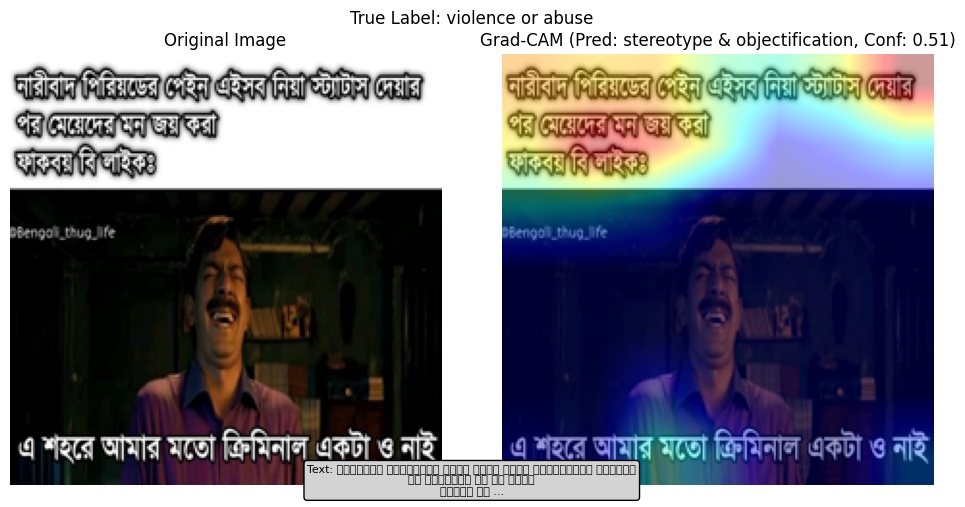

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:13, 13.61s/it]               


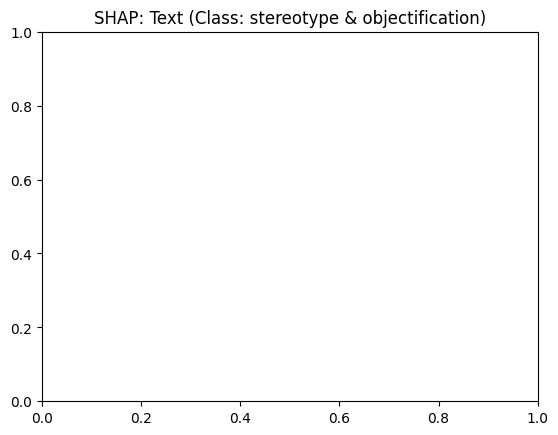


📘 Misclassified Sample 2 | True Label: stereotype & objectification | Predicted: violence or abuse (0.54)


Glyph 2476 (\N{BENGALI LETTER BA}) missing from current font.
Matplotlib currently does not support Bengali natively.
Glyph 2503 (\N{BENGALI VOWEL SIGN E}) missing from current font.
Glyph 2495 (\N{BENGALI VOWEL SIGN I}) missing from current font.
Glyph 2438 (\N{BENGALI LETTER AA}) missing from current font.
Glyph 2460 (\N{BENGALI LETTER JA}) missing from current font.
Glyph 2469 (\N{BENGALI LETTER THA}) missing from current font.
Glyph 2453 (\N{BENGALI LETTER KA}) missing from current font.
Glyph 2478 (\N{BENGALI LETTER MA}) missing from current font.
Glyph 2494 (\N{BENGALI VOWEL SIGN AA}) missing from current font.
Glyph 2480 (\N{BENGALI LETTER RA}) missing from current font.
Glyph 2471 (\N{BENGALI LETTER DHA}) missing from current font.
Glyph 2507 (\N{BENGALI VOWEL SIGN O}) missing from current font.
Glyph 2472 (\N{BENGALI LETTER NA}) missing from current font.
Glyph 2488 (\N{BENGALI LETTER SA}) missing from current font.
Glyph 2509 (\N{BENGALI SIGN VIRAMA}) missing from current fon

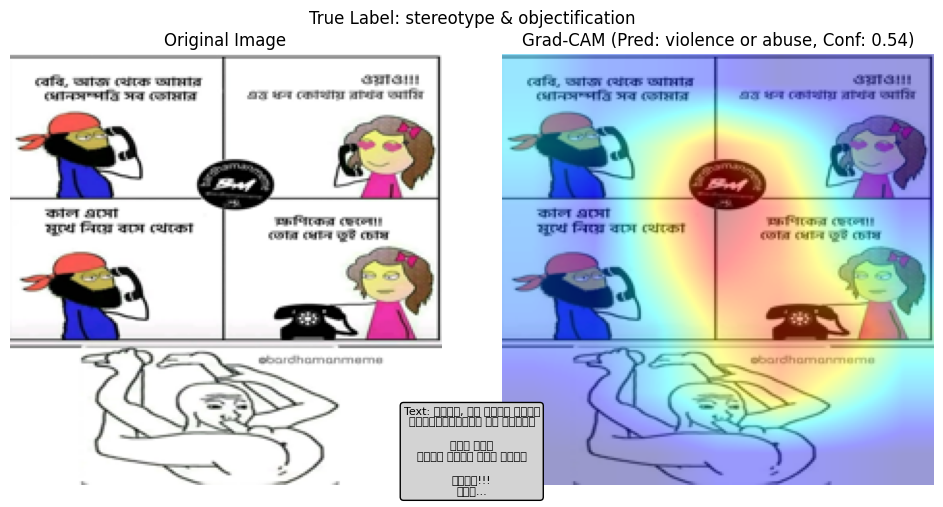

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:10, 10.95s/it]               


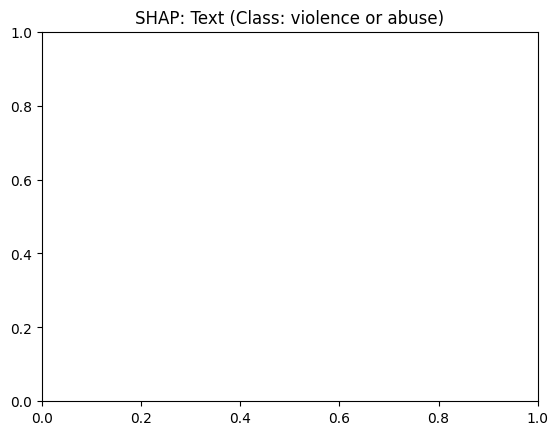


📘 Misclassified Sample 3 | True Label: stereotype & objectification | Predicted: violence or abuse (0.54)


Glyph 2486 (\N{BENGALI LETTER SHA}) missing from current font.
Glyph 2479 (\N{BENGALI LETTER YA}) missing from current font.
Glyph 2437 (\N{BENGALI LETTER A}) missing from current font.
Glyph 2477 (\N{BENGALI LETTER BHA}) missing from current font.
Glyph 2487 (\N{BENGALI LETTER SSA}) missing from current font.
Glyph 2464 (\N{BENGALI LETTER TTHA}) missing from current font.


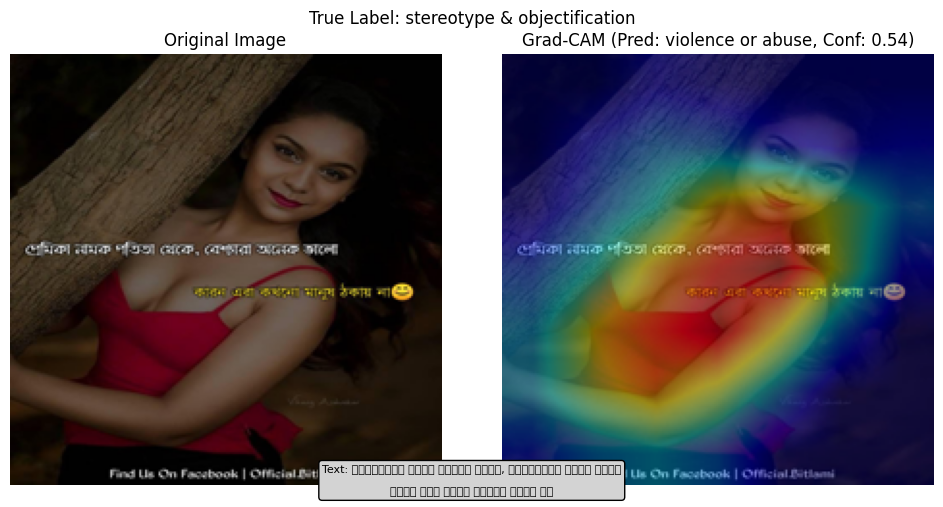

  0%|          | 0/306 [00:00<?, ?it/s]

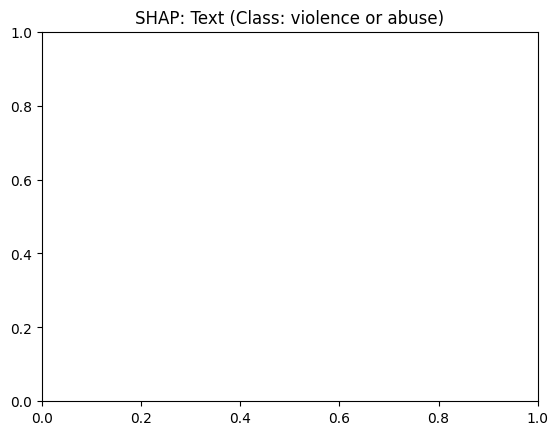


📘 Misclassified Sample 4 | True Label: violence or abuse | Predicted: stereotype & objectification (0.54)


Glyph 2433 (\N{BENGALI SIGN CANDRABINDU}) missing from current font.
Glyph 2470 (\N{BENGALI LETTER DA}) missing from current font.
) missing from current font.
Glyph 2404 (\N{DEVANAGARI DANDA}) missing from current font.
Matplotlib currently does not support Devanagari natively.
Glyph 2492 (\N{BENGALI SIGN NUKTA}) missing from current font.
Glyph 2463 (\N{BENGALI LETTER TTA}) missing from current font.
Glyph 2459 (\N{BENGALI LETTER CHA}) missing from current font.
Glyph 2489 (\N{BENGALI LETTER HA}) missing from current font.


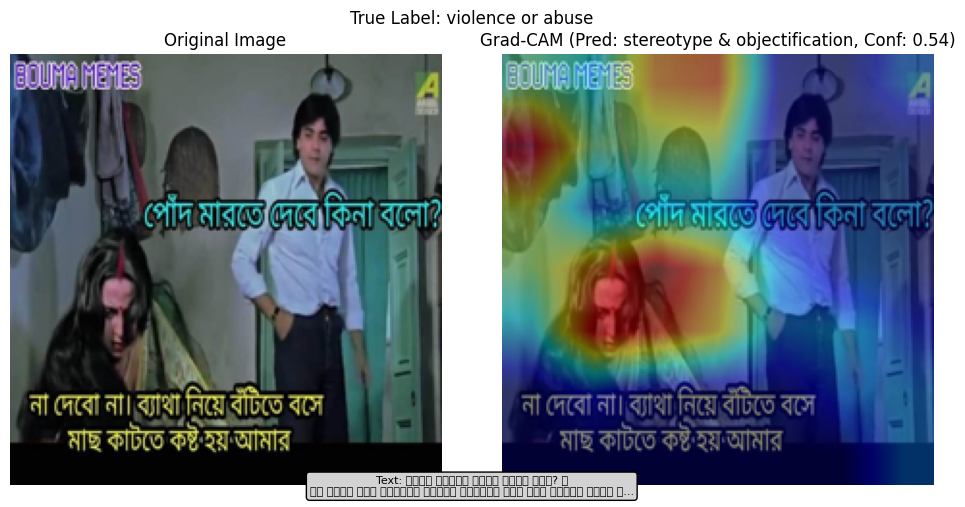

  0%|          | 0/498 [00:00<?, ?it/s]

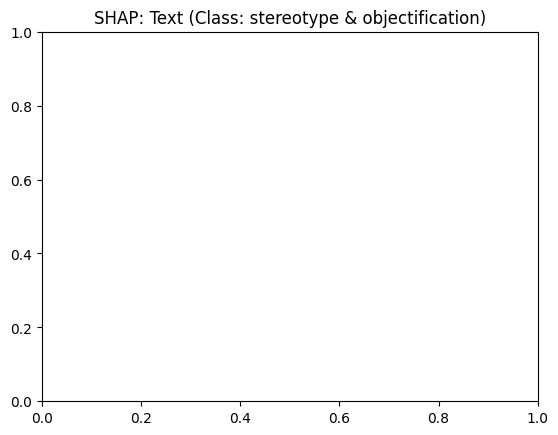


📘 Misclassified Sample 5 | True Label: violence or abuse | Predicted: stereotype & objectification (0.55)


Glyph 2441 (\N{BENGALI LETTER U}) missing from current font.
Glyph 2508 (\N{BENGALI VOWEL SIGN AU}) missing from current font.
Glyph 2439 (\N{BENGALI LETTER I}) missing from current font.


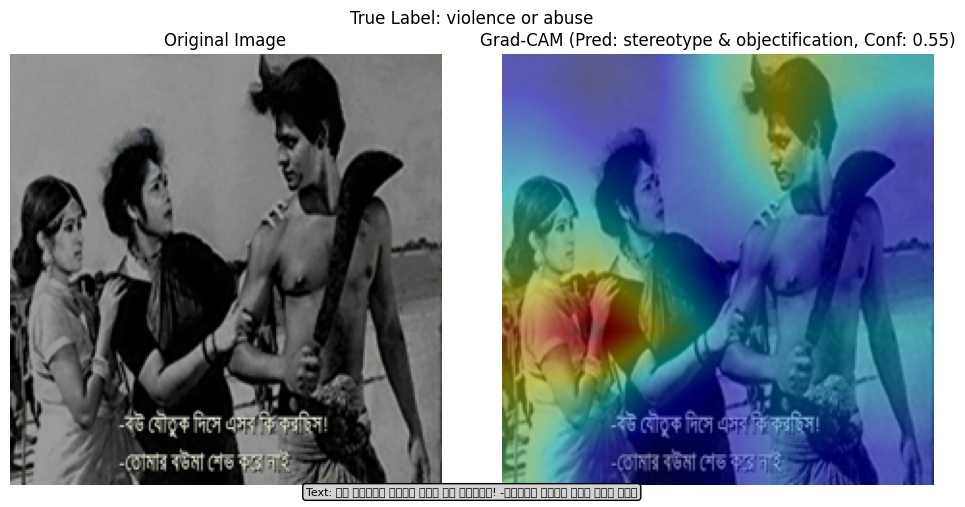

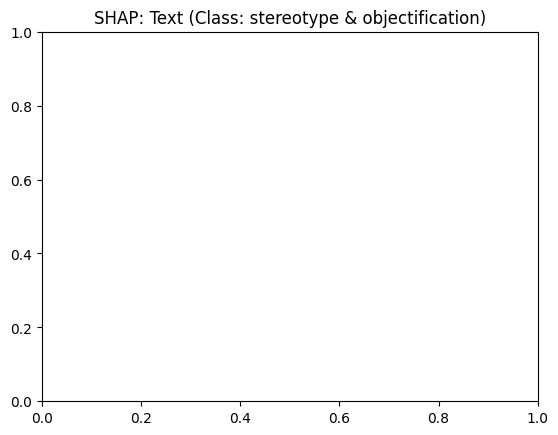


📘 Misclassified Sample 6 | True Label: non-misogynistic | Predicted: violence or abuse (0.58)


Glyph 2524 (\N{BENGALI LETTER RRA}) missing from current font.
Glyph 2496 (\N{BENGALI VOWEL SIGN II}) missing from current font.
Glyph 2457 (\N{BENGALI LETTER NGA}) missing from current font.
Glyph 2455 (\N{BENGALI LETTER GA}) missing from current font.
Glyph 2467 (\N{BENGALI LETTER NNA}) missing from current font.
Glyph 2435 (\N{BENGALI SIGN VISARGA}) missing from current font.


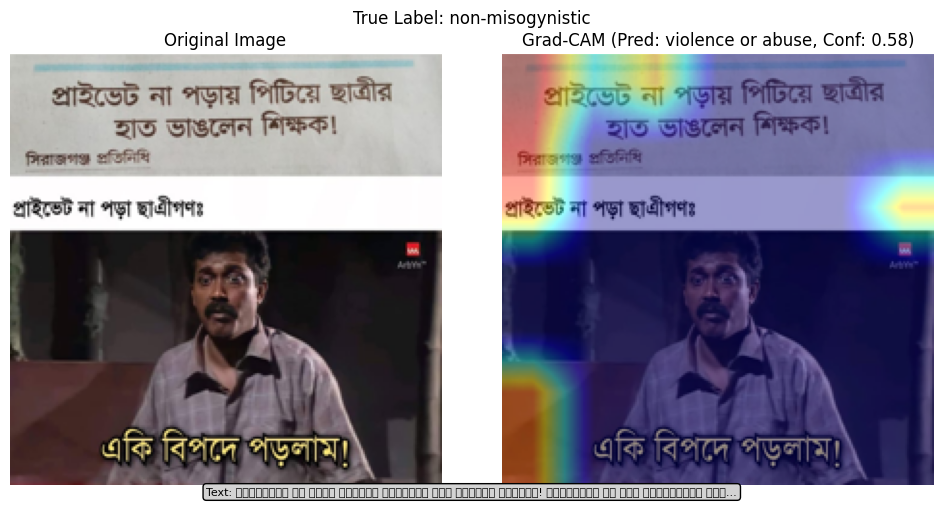

  0%|          | 0/462 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:10, 10.38s/it]               


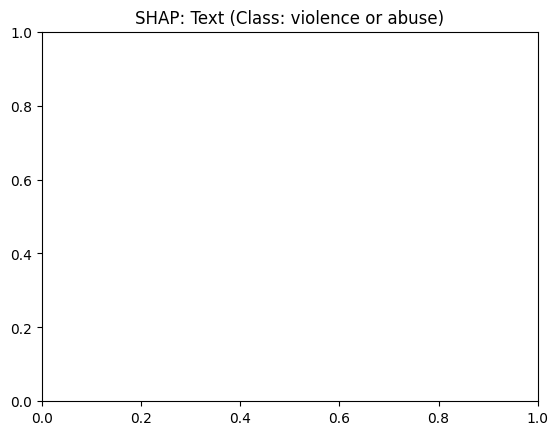


📘 Misclassified Sample 7 | True Label: violence or abuse | Predicted: stereotype & objectification (0.59)


Glyph 2456 (\N{BENGALI LETTER GHA}) missing from current font.


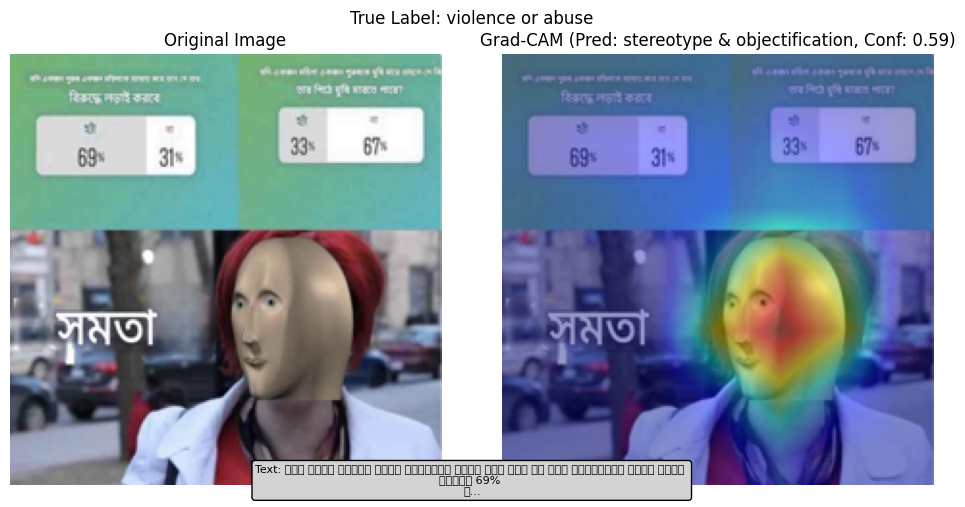

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:10, 10.44s/it]               


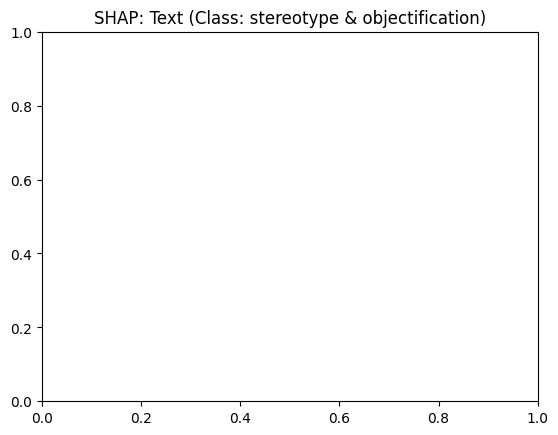


📘 Misclassified Sample 8 | True Label: non-misogynistic | Predicted: stereotype & objectification (0.59)


Glyph 2498 (\N{BENGALI VOWEL SIGN UU}) missing from current font.
Glyph 2458 (\N{BENGALI LETTER CA}) missing from current font.


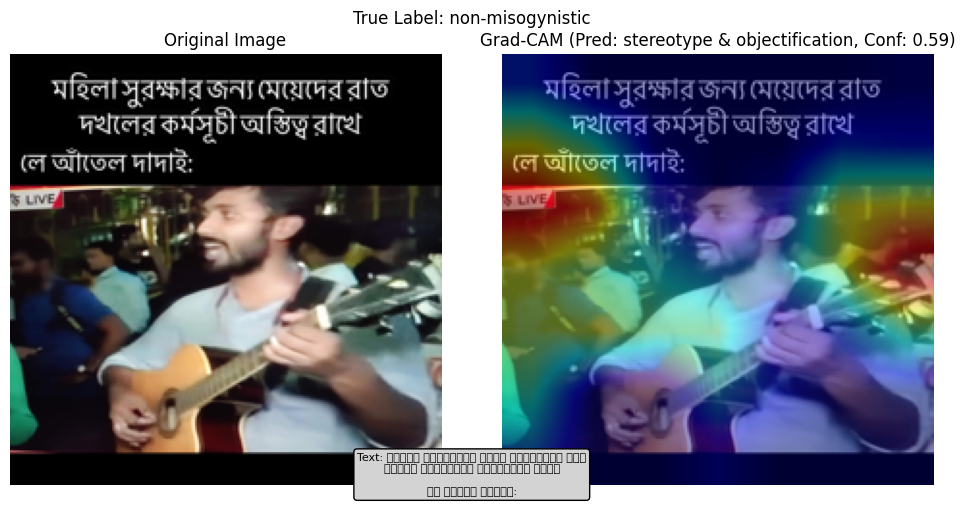

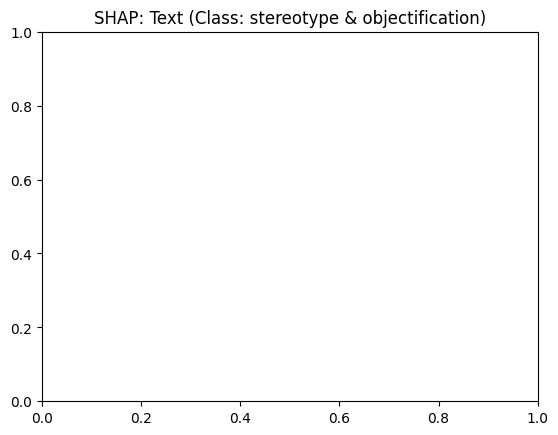


📘 Misclassified Sample 9 | True Label: violence or abuse | Predicted: stereotype & objectification (0.61)


Glyph 2465 (\N{BENGALI LETTER DDA}) missing from current font.


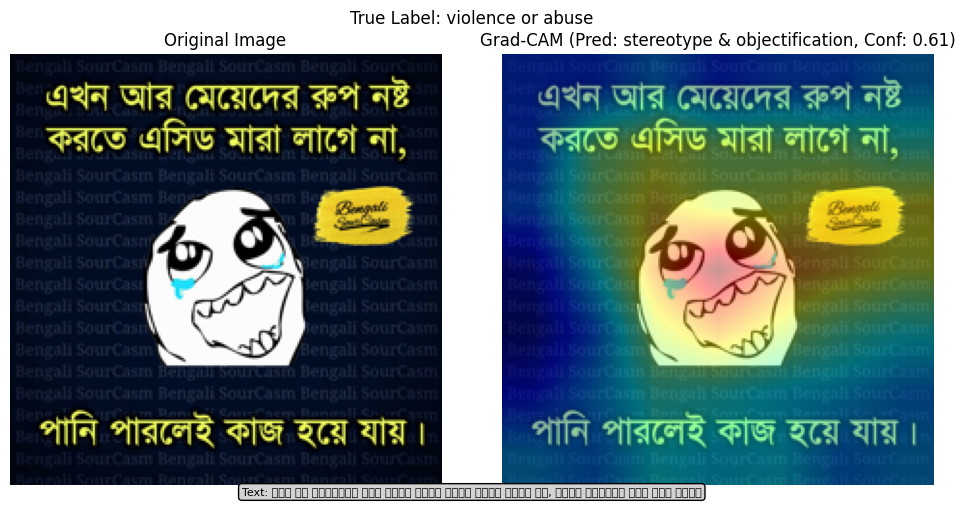

  0%|          | 0/342 [00:00<?, ?it/s]

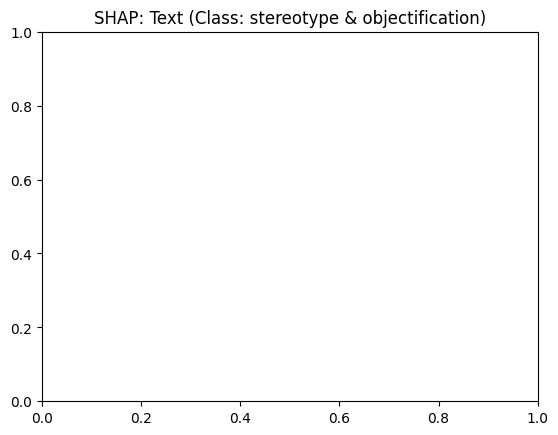


📘 Misclassified Sample 10 | True Label: stereotype & objectification | Predicted: non-misogynistic (0.63)


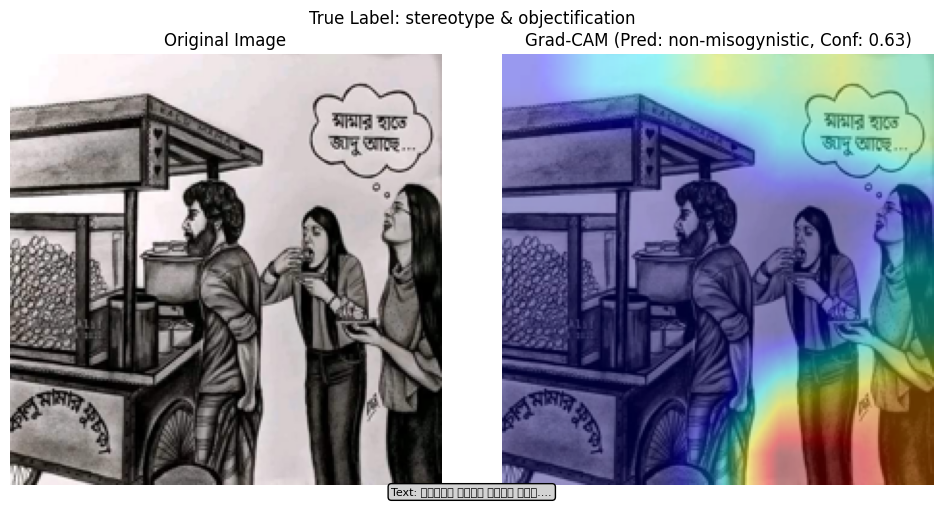

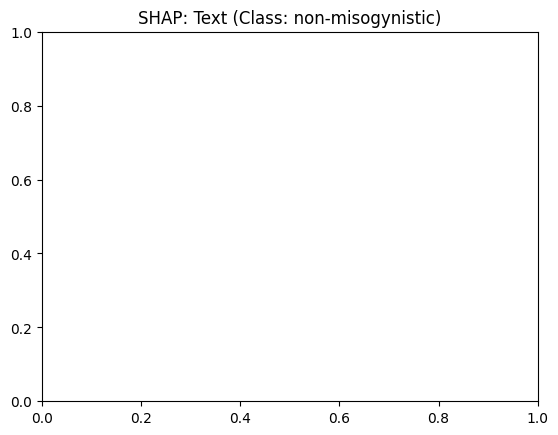

In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from PIL import Image
from transformers import AutoModel, AutoTokenizer
import timm
import matplotlib.pyplot as plt
import numpy as np
import cv2
import shap
import joblib
from sklearn.metrics import classification_report, confusion_matrix
from tqdm.notebook import tqdm

# Device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using:", device)



# ======================= DATASET =========================
class MemeDataset(Dataset):
    def __init__(self, dataframe, img_dir, tokenizer, transform):
        self.data = dataframe
        self.img_dir = img_dir
        self.tokenizer = tokenizer
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        row = self.data.iloc[idx]
        image_path = os.path.join(self.img_dir, row["image"])
        image = self.transform(Image.open(image_path).convert("RGB"))
        text = row["text"]
        label = label2idx[row["label"]]

        encoding = self.tokenizer(text, padding="max_length", truncation=True, max_length=64, return_tensors="pt")
        return {
            "image": image,
            "input_ids": encoding["input_ids"].squeeze(0),
            "attention_mask": encoding["attention_mask"].squeeze(0),
            "label": torch.tensor(label)
        }

# ======================= MODEL =========================
class MultiModalModel(nn.Module):
    def __init__(self, text_model_name="csebuetnlp/banglabert", image_model_name="efficientnet_b0", num_classes=3):
        super().__init__()
        self.text_encoder = AutoModel.from_pretrained(text_model_name)
        self.text_proj = nn.Linear(self.text_encoder.config.hidden_size, 256)
        self.image_encoder = timm.create_model(image_model_name, pretrained=True, num_classes=0)
        self.image_proj = nn.Linear(self.image_encoder.num_features, 128)
        self.fusion = nn.Sequential(
            nn.Linear(256 + 128, 256),
            nn.ReLU(),
            nn.Dropout(0.3)
        )
        self.text_head = nn.Linear(256, num_classes)
        self.image_head = nn.Linear(128, num_classes)
        self.fusion_head = nn.Linear(256, num_classes)
        self.final_fusion = nn.Linear(num_classes * 3, num_classes)

    def forward(self, input_ids, attention_mask, image):
        text_outputs = self.text_encoder(input_ids=input_ids, attention_mask=attention_mask)
        text_global = text_outputs.last_hidden_state[:, 0]
        text_embed = self.text_proj(text_global)
        image_global = self.image_encoder(image)
        image_embed = self.image_proj(image_global)
        combined = torch.cat([text_embed, image_embed], dim=1)
        fused = self.fusion(combined)
        text_logits = self.text_head(text_embed)
        image_logits = self.image_head(image_embed)
        fusion_logits = self.fusion_head(fused)
        combined_logits = torch.cat([text_logits, image_logits, fusion_logits], dim=1)
        final_logits = self.final_fusion(combined_logits)
        return text_logits, image_logits, fusion_logits, final_logits

# Load saved model and metadata
model_path = "/kaggle/working/saved_models/multimodal_model_for_xai.pth"
checkpoint = torch.load(model_path, map_location=device, weights_only=False)
label_encoder = joblib.load("/kaggle/working/saved_models/label_encoder.pkl")
tokenizer_config = joblib.load("/kaggle/working/saved_models/tokenizer_config.pkl")
transform_config = joblib.load("/kaggle/working/saved_models/transform_config.pkl")

tokenizer = AutoTokenizer.from_pretrained(tokenizer_config['model_name'])
transform = transforms.Compose([
    transforms.Resize(transform_config['resize']),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

model = MultiModalModel().to(device)
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

# Load dataset
csv_path = "/kaggle/input/less-data/changed_ds/new_ds_small.csv"
img_dir = "/kaggle/input/less-data/changed_ds/img/"
df = pd.read_csv(csv_path)
df = df.rename(columns={"Unnamed: 0": "image"})
df = df[df['label'].isin(label2idx.keys())]

dataset = MemeDataset(df, img_dir, tokenizer, transform)
test_size = int(0.2 * len(dataset))
train_val_size = len(dataset) - test_size
train_val_ds, test_ds = random_split(dataset, [train_val_size, test_size])
test_loader = DataLoader(test_ds, batch_size=16, shuffle=False)

# ======================= FIND MISCLASSIFIED SAMPLES =========================
def find_misclassified_samples(model, test_loader, dataset, num_samples=10):
    model.eval()
    misclassified = []

    with torch.no_grad():
        batch_idx = 0
        for batch in tqdm(test_loader, desc="Finding misclassified samples"):
            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)
            image = batch["image"].to(device)
            labels = batch["label"].to(device)

            text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, image)
            predictions = torch.argmax(final_logits, dim=1)
            probs = torch.softmax(final_logits, dim=1)
            confidence_scores = torch.max(probs, dim=1)[0]

            for i in range(len(predictions)):
                if predictions[i] != labels[i]:
                    actual_idx = test_loader.dataset.indices[batch_idx * test_loader.batch_size + i]
                    original_data = dataset.data.iloc[actual_idx]

                    misclassified.append({
                        'index': actual_idx,
                        'image_path': original_data['image'],
                        'text': original_data['text'],
                        'true_label': idx2label[labels[i].item()],
                        'predicted_label': idx2label[predictions[i].item()],
                        'confidence': confidence_scores[i].item(),
                        'true_label_idx': labels[i].item(),
                        'predicted_label_idx': predictions[i].item()
                    })

            batch_idx += 1

    misclassified.sort(key=lambda x: x['confidence'])
    return misclassified[:num_samples]

# ======================= GRAD-CAM =========================
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        self.hook_handles = []
        self._register_hooks()

    def _register_hooks(self):
        def forward_hook(module, input, output):
            self.activations = output

        def backward_hook(module, grad_in, grad_out):
            self.gradients = grad_out[0]

        self.hook_handles.append(self.target_layer.register_forward_hook(forward_hook))
        self.hook_handles.append(self.target_layer.register_full_backward_hook(backward_hook))

    def __call__(self, input_ids, attention_mask, image, class_idx):
        self.model.zero_grad()
        text_logits, image_logits, fusion_logits, final_logits = self.model(input_ids, attention_mask, image)
        target = final_logits[:, class_idx]
        target.backward()

        gradients = self.gradients.detach().cpu().numpy()
        activations = self.activations.detach().cpu().numpy()
        weights = np.mean(gradients, axis=(2, 3))
        cam = np.zeros(activations.shape[2:], dtype=np.float32)

        for i, w in enumerate(weights[0]):
            cam += w * activations[0, i]

        cam = np.maximum(cam, 0)
        cam = cv2.resize(cam, (224, 224))
        cam = cam - np.min(cam)
        cam = cam / (np.max(cam) + 1e-8)
        return cam

    def __del__(self):
        for handle in self.hook_handles:
            handle.remove()

# ======================= SHAP for TEXT =========================
def predict_shap(texts, class_idx):
    probs = []
    for text in texts:
        input_ids = tokenizer(text, return_tensors="pt", truncation=True, padding="max_length", max_length=64)["input_ids"].to(device)
        attention_mask = tokenizer(text, return_tensors="pt", truncation=True, padding="max_length", max_length=64)["attention_mask"].to(device)
        dummy_image = torch.zeros((1, 3, 224, 224)).to(device)

        with torch.no_grad():
            text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, dummy_image)
            prob = F.softmax(final_logits, dim=1)[0, class_idx].item()
        probs.append(prob)
    return np.array(probs)

# ======================= VISUALIZE XAI =========================
def visualize_xai(sample, img_dir, max_text_length=80):
    img_path = os.path.join(img_dir, sample['image_path'])
    text = sample['text']
    true_label = sample['true_label']
    pred_label = sample['predicted_label']
    pred_idx = sample['predicted_label_idx']
    confidence = sample['confidence']

    # Prepare inputs
    inputs = tokenizer(text, return_tensors="pt", truncation=True, padding="max_length", max_length=64)
    input_ids = inputs["input_ids"].to(device)
    attention_mask = inputs["attention_mask"].to(device)
    image = transform(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device)

    # Grad-CAM
    target_layer = model.image_encoder.conv_head
    gradcam = GradCAM(model, target_layer)
    cam = gradcam(input_ids, attention_mask, image, pred_idx)

    # Visualize Grad-CAM
    img_pil = Image.open(img_path).convert("RGB").resize((224, 224))
    img_np = np.array(img_pil, dtype=np.uint8)  # Ensure uint8
    img_np = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)  # Convert RGB to BGR
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)  # 3-channel BGR heatmap
    overlay = cv2.addWeighted(img_np, 0.6, heatmap, 0.4, 0)  # Both inputs are uint8, BGR, (224, 224, 3)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    ax1.imshow(cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB))  # Convert back to RGB for display
    ax1.set_title("Original Image")
    ax1.axis("off")
    ax2.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))  # Convert back to RGB for display
    ax2.set_title(f"Grad-CAM (Pred: {pred_label}, Conf: {confidence:.2f})")
    ax2.axis("off")
    plt.suptitle(f"True Label: {true_label}")
    plt.tight_layout()

    # Truncate text for display
    display_text = text if len(text) <= max_text_length else text[:max_text_length] + "..."
    plt.figtext(0.5, 0.01, f"Text: {display_text}", ha="center", fontsize=8, bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgray"))
    plt.show()

    # SHAP for text
    masker = shap.maskers.Text(tokenizer)
    explainer = shap.Explainer(lambda x: predict_shap(x, pred_idx), masker)
    shap_vals = explainer([text])
    shap.plots.text(shap_vals[0])
    plt.title(f"SHAP: Text (Class: {pred_label})")
    plt.show()

# ======================= RUN XAI FOR MISCLASSIFIED SAMPLES =========================
print("Finding 10 misclassified samples...")
misclassified_samples = find_misclassified_samples(model, test_loader, dataset, num_samples=10)

# Analyze patterns
print("\nAnalyzing misclassified samples...")
df_misclassified = pd.DataFrame(misclassified_samples)
print("=" * 50)
print("MISCLASSIFIED SAMPLES ANALYSIS")
print("=" * 50)
print(f"Total misclassified samples: {len(df_misclassified)}")
print(f"Average confidence: {df_misclassified['confidence'].mean():.3f}")
print(f"Confidence range: {df_misclassified['confidence'].min():.3f} - {df_misclassified['confidence'].max():.3f}")
print("\nConfusion Patterns:")
confusion_counts = df_misclassified.groupby(['true_label', 'predicted_label']).size()
for (true_label, pred_label), count in confusion_counts.items():
    print(f"  {true_label} -> {pred_label}: {count} samples")
df_misclassified['text_length'] = df_misclassified['text'].str.len()
print(f"\nText Length Analysis:")
print(f"  Average text length: {df_misclassified['text_length'].mean():.1f} characters")
print(f"  Text length range: {df_misclassified['text_length'].min()} - {df_misclassified['text_length'].max()}")

# Run XAI on misclassified samples
print("\nRunning explainability analysis...")
for idx, sample in enumerate(misclassified_samples):
    print(f"\n📘 Misclassified Sample {idx+1} | True Label: {sample['true_label']} | Predicted: {sample['predicted_label']} ({sample['confidence']:.2f})")
    visualize_xai(sample, img_dir)

Using: cuda
Finding 10 misclassified samples...

Analyzing misclassified samples...
MISCLASSIFIED SAMPLES ANALYSIS
Total misclassified samples: 15
Average confidence: 0.761
Confidence range: 0.524 - 0.986

Confusion Patterns:
  non-misogynistic -> stereotype & objectification: 5 samples
  non-misogynistic -> violence or abuse: 1 samples
  stereotype & objectification -> non-misogynistic: 5 samples
  violence or abuse -> non-misogynistic: 1 samples
  violence or abuse -> stereotype & objectification: 3 samples

Text Length Analysis:
  Average text length: 131.1 characters
  Text length range: 37 - 778

Running explainability analysis...

📘 Misclassified Sample 1 | True Label: stereotype & objectification | Predicted: non-misogynistic (0.81)


Glyph 2459 (\N{BENGALI LETTER CHA}) missing from current font.
Matplotlib currently does not support Bengali natively.
Glyph 2503 (\N{BENGALI VOWEL SIGN E}) missing from current font.
Glyph 2482 (\N{BENGALI LETTER LA}) missing from current font.
Glyph 2480 (\N{BENGALI LETTER RA}) missing from current font.
Glyph 2494 (\N{BENGALI VOWEL SIGN AA}) missing from current font.
Glyph 2479 (\N{BENGALI LETTER YA}) missing from current font.
Glyph 2477 (\N{BENGALI LETTER BHA}) missing from current font.
Glyph 2476 (\N{BENGALI LETTER BA}) missing from current font.
Glyph 2455 (\N{BENGALI LETTER GA}) missing from current font.
Glyph 2497 (\N{BENGALI VOWEL SIGN U}) missing from current font.
Glyph 2488 (\N{BENGALI LETTER SA}) missing from current font.
Glyph 2509 (\N{BENGALI SIGN VIRAMA}) missing from current font.
Glyph 2458 (\N{BENGALI LETTER CA}) missing from current font.
Glyph 2453 (\N{BENGALI LETTER KA}) missing from current font.
Glyph 2474 (\N{BENGALI LETTER PA}) missing from current font.


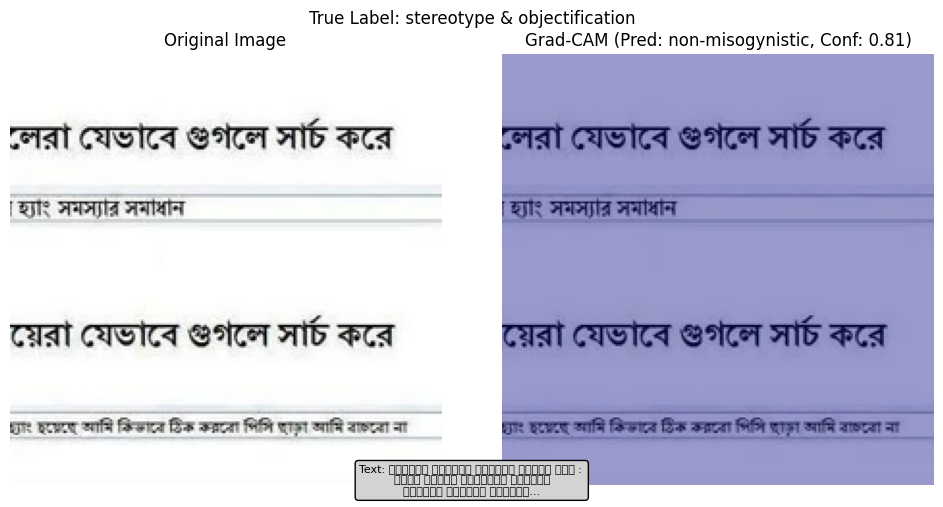

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:10, 10.02s/it]               


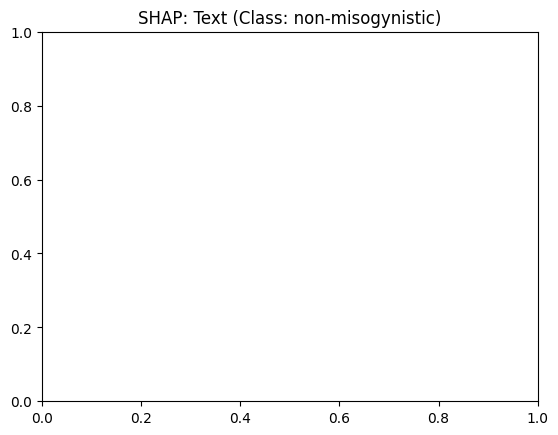


📘 Misclassified Sample 2 | True Label: non-misogynistic | Predicted: stereotype & objectification (0.84)


Glyph 2460 (\N{BENGALI LETTER JA}) missing from current font.
Glyph 2468 (\N{BENGALI LETTER TA}) missing from current font.
Glyph 2463 (\N{BENGALI LETTER TTA}) missing from current font.
Glyph 2470 (\N{BENGALI LETTER DA}) missing from current font.
Glyph 2524 (\N{BENGALI LETTER RRA}) missing from current font.
Glyph 2507 (\N{BENGALI VOWEL SIGN O}) missing from current font.
Glyph 2451 (\N{BENGALI LETTER O}) missing from current font.
Glyph 2454 (\N{BENGALI LETTER KHA}) missing from current font.


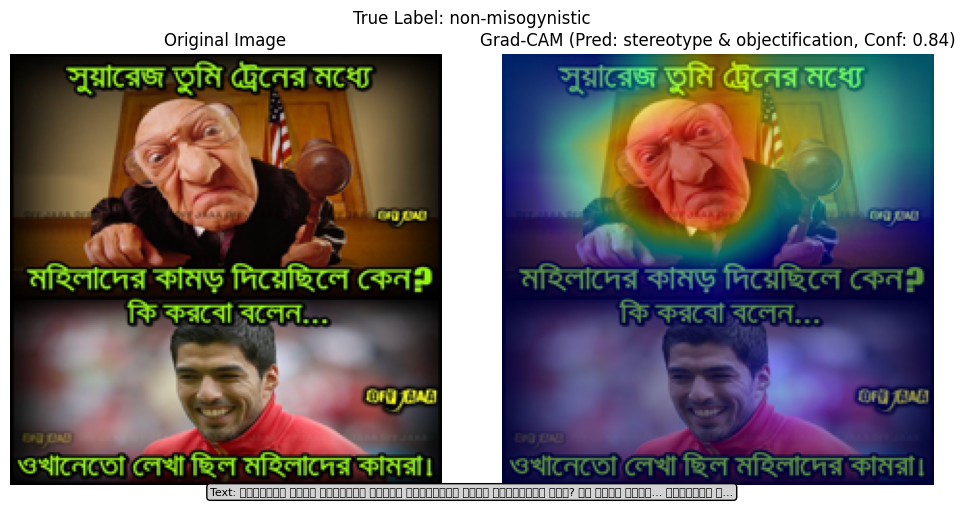

  0%|          | 0/498 [00:00<?, ?it/s]

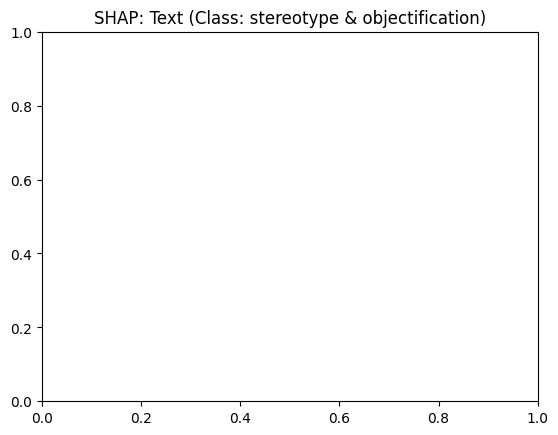


📘 Misclassified Sample 3 | True Label: stereotype & objectification | Predicted: non-misogynistic (0.80)


Glyph 2496 (\N{BENGALI VOWEL SIGN II}) missing from current font.
Glyph 2487 (\N{BENGALI LETTER SSA}) missing from current font.
Glyph 2492 (\N{BENGALI SIGN NUKTA}) missing from current font.


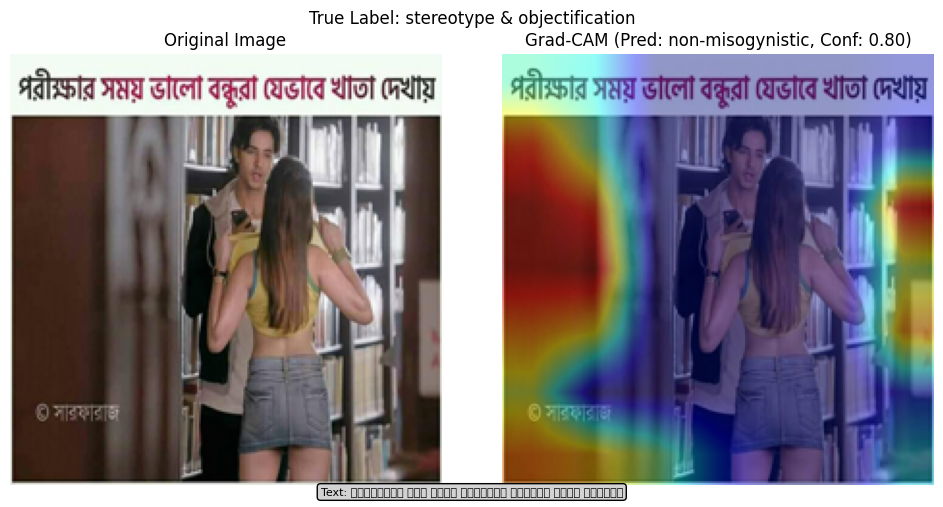

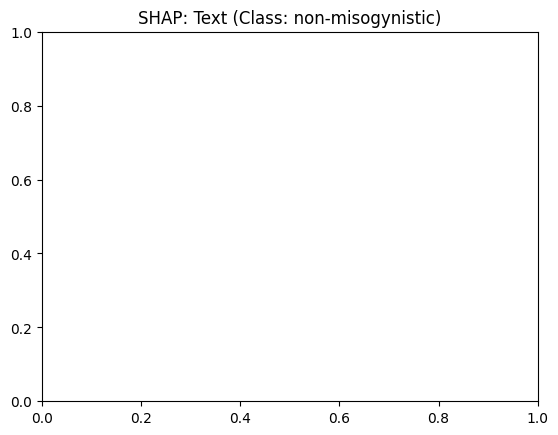


📘 Misclassified Sample 4 | True Label: violence or abuse | Predicted: stereotype & objectification (0.78)


Glyph 2438 (\N{BENGALI LETTER AA}) missing from current font.
Glyph 2475 (\N{BENGALI LETTER PHA}) missing from current font.
Glyph 2508 (\N{BENGALI VOWEL SIGN AU}) missing from current font.
Glyph 2469 (\N{BENGALI LETTER THA}) missing from current font.
Glyph 2447 (\N{BENGALI LETTER E}) missing from current font.
Glyph 2439 (\N{BENGALI LETTER I}) missing from current font.
Glyph 2433 (\N{BENGALI SIGN CANDRABINDU}) missing from current font.


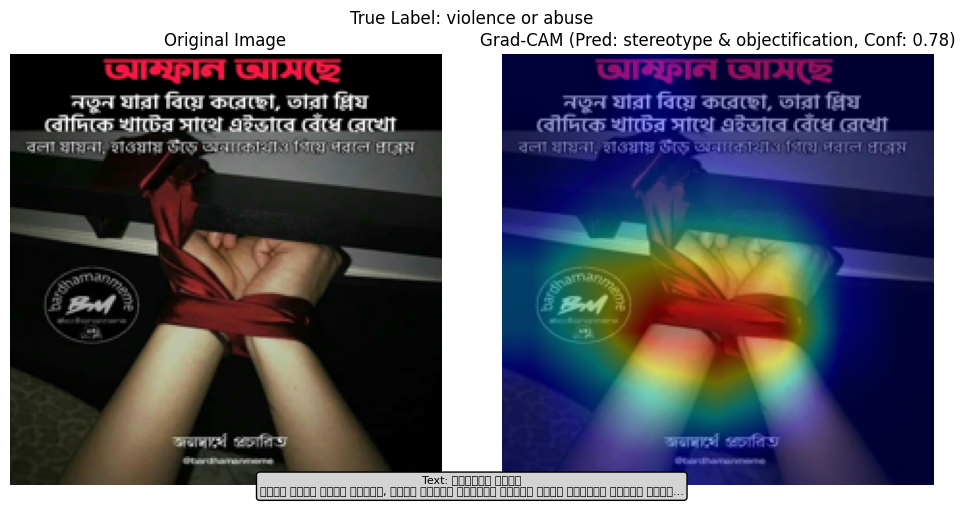

  0%|          | 0/498 [00:00<?, ?it/s]

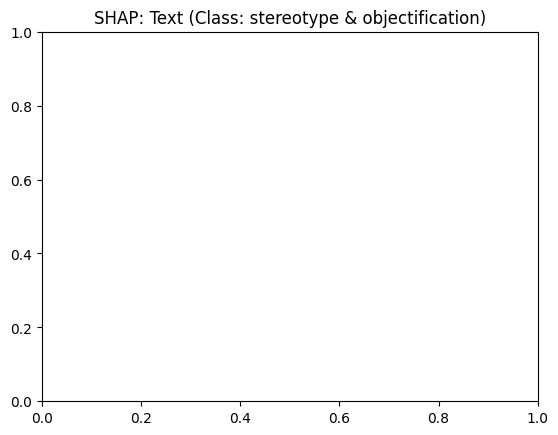


📘 Misclassified Sample 5 | True Label: stereotype & objectification | Predicted: non-misogynistic (0.98)


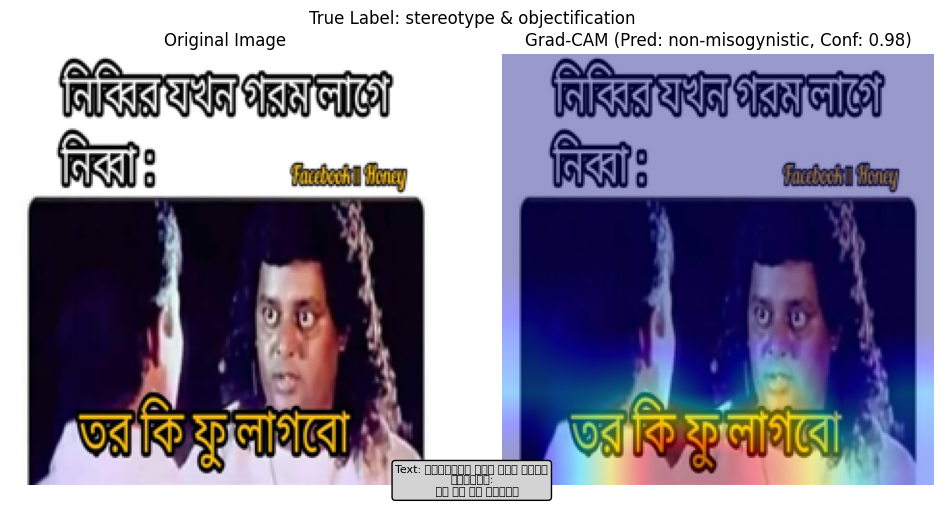

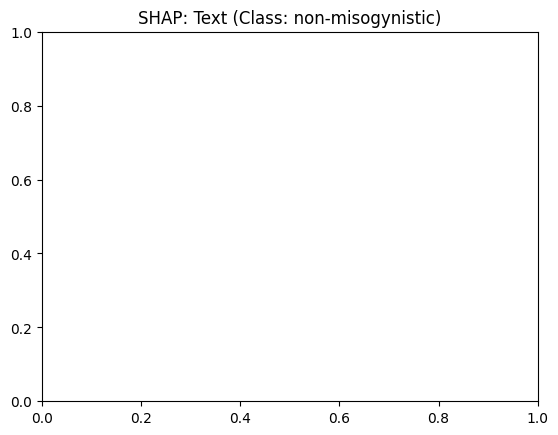


📘 Misclassified Sample 6 | True Label: stereotype & objectification | Predicted: non-misogynistic (0.98)


Glyph 2464 (\N{BENGALI LETTER TTHA}) missing from current font.


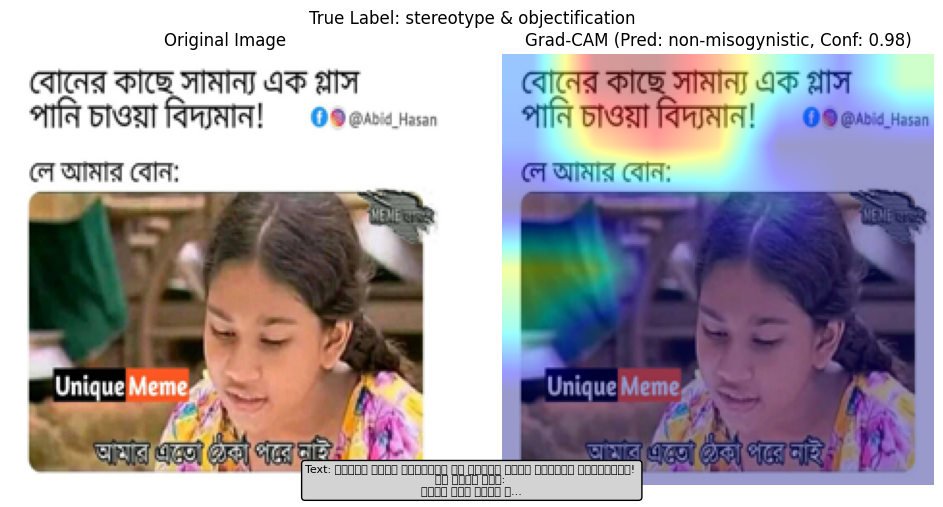

  0%|          | 0/420 [00:00<?, ?it/s]

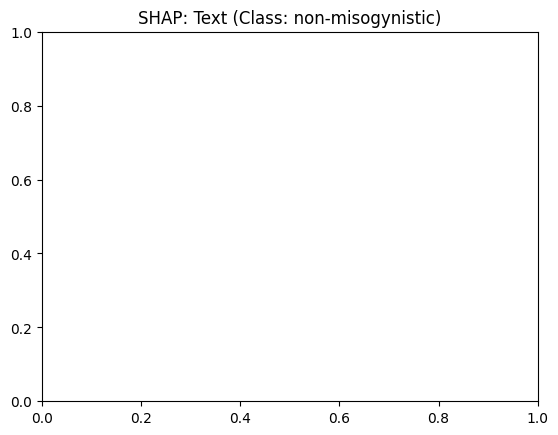


📘 Misclassified Sample 7 | True Label: non-misogynistic | Predicted: violence or abuse (0.81)


Glyph 2486 (\N{BENGALI LETTER SHA}) missing from current font.


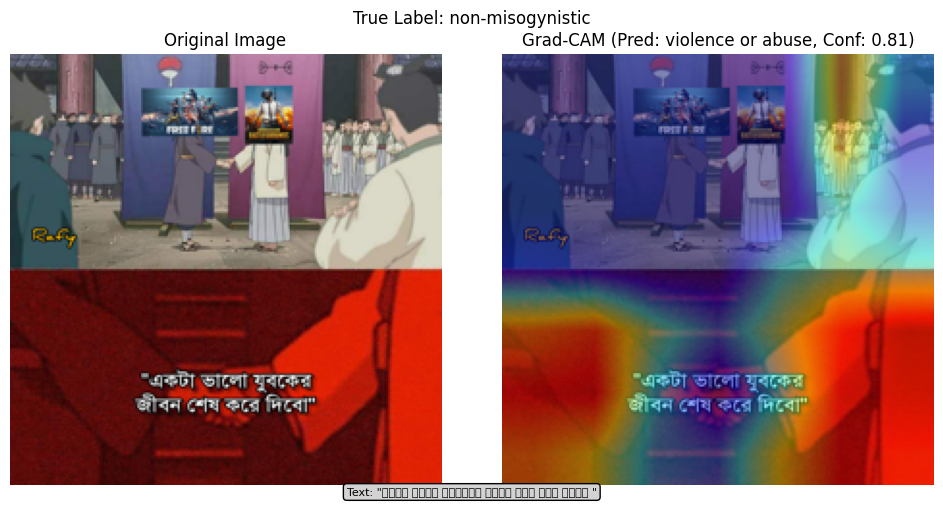

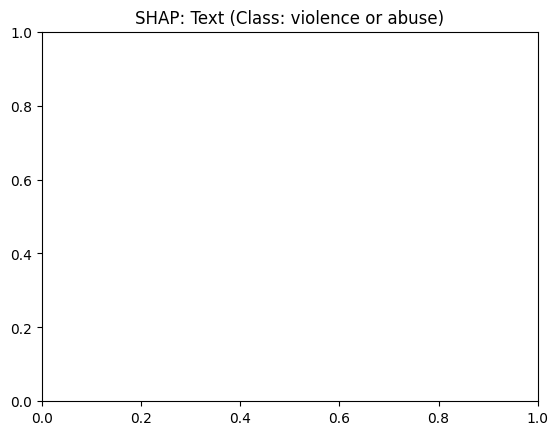


📘 Misclassified Sample 8 | True Label: non-misogynistic | Predicted: stereotype & objectification (0.68)


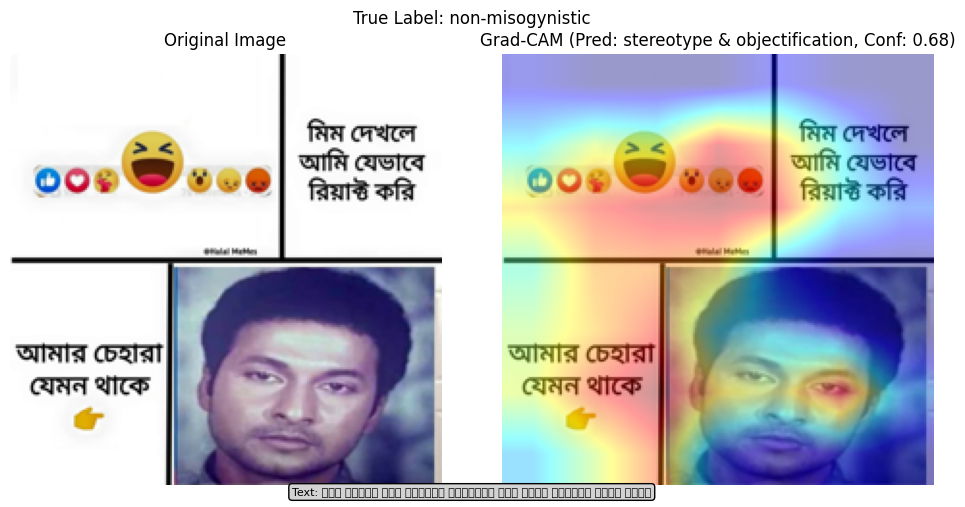

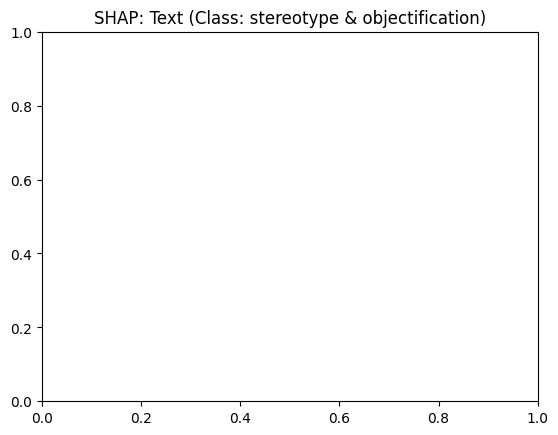


📘 Misclassified Sample 9 | True Label: non-misogynistic | Predicted: stereotype & objectification (0.80)


Glyph 2457 (\N{BENGALI LETTER NGA}) missing from current font.


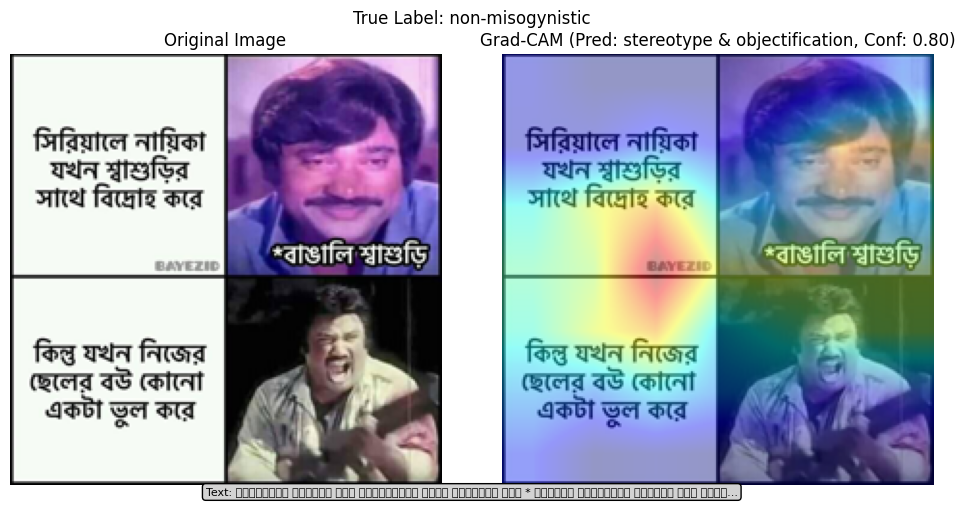

  0%|          | 0/420 [00:00<?, ?it/s]

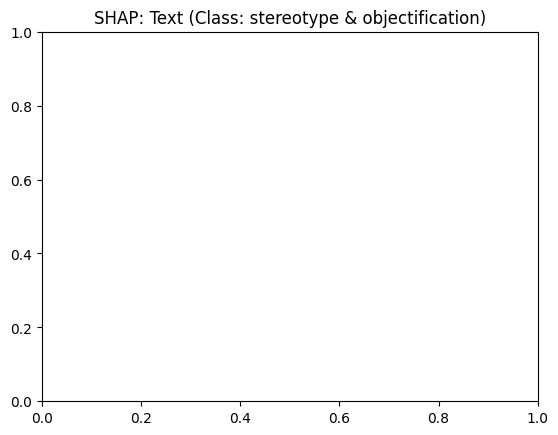


📘 Misclassified Sample 10 | True Label: stereotype & objectification | Predicted: non-misogynistic (0.99)


Glyph 2465 (\N{BENGALI LETTER DDA}) missing from current font.


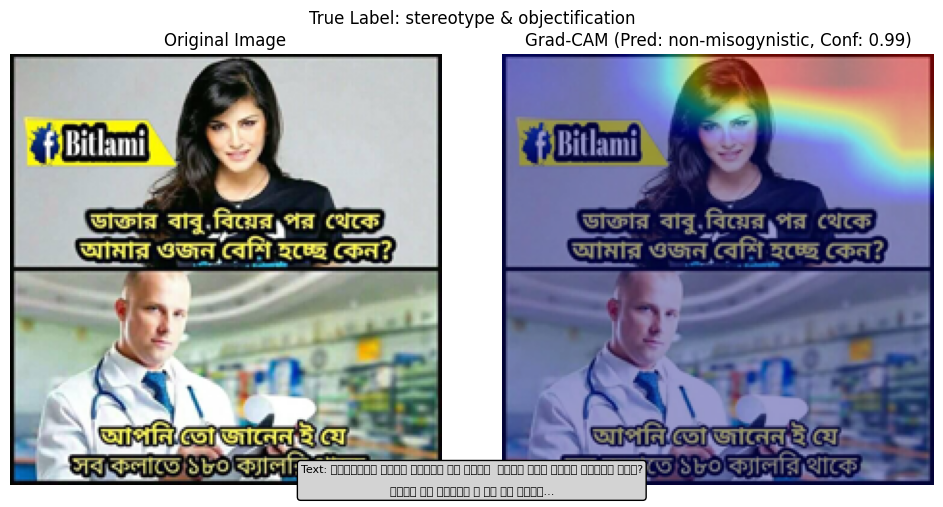

  0%|          | 0/498 [00:00<?, ?it/s]

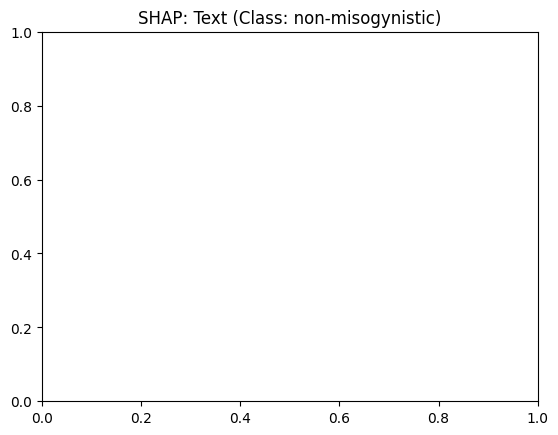


📘 Misclassified Sample 11 | True Label: violence or abuse | Predicted: stereotype & objectification (0.52)


Glyph 2404 (\N{DEVANAGARI DANDA}) missing from current font.
Matplotlib currently does not support Devanagari natively.


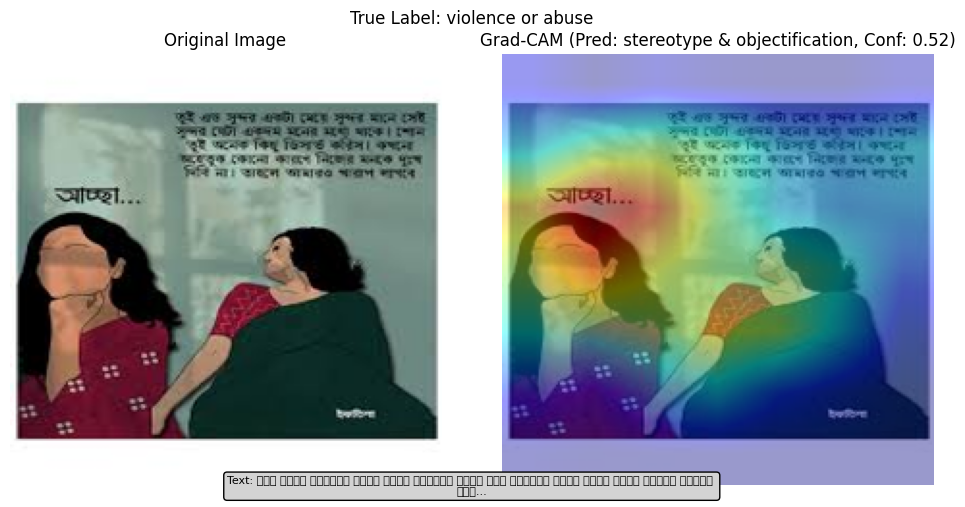

  0%|          | 0/420 [00:00<?, ?it/s]

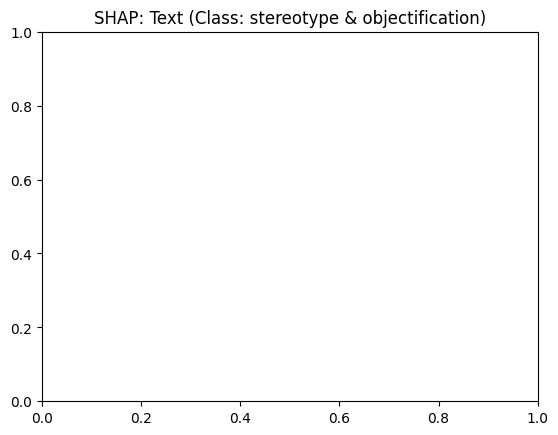


📘 Misclassified Sample 12 | True Label: violence or abuse | Predicted: stereotype & objectification (0.55)


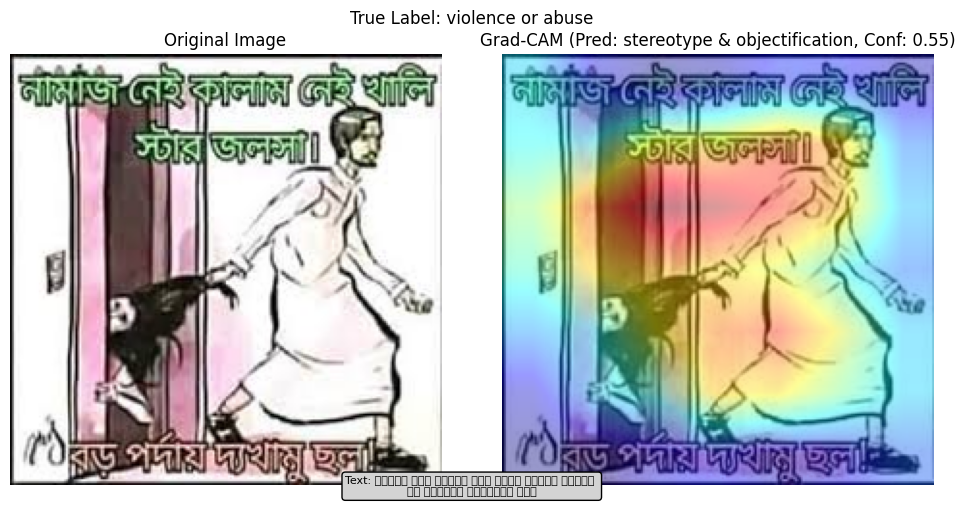

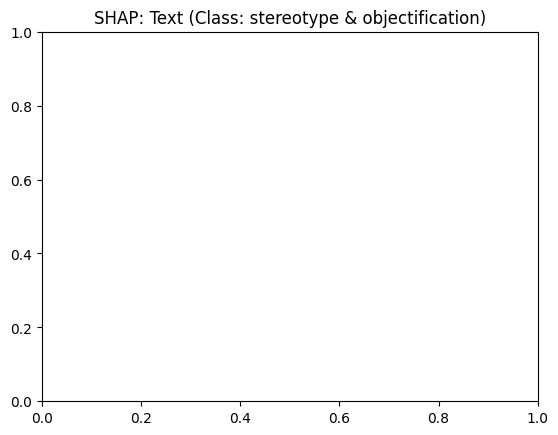


📘 Misclassified Sample 13 | True Label: non-misogynistic | Predicted: stereotype & objectification (0.55)


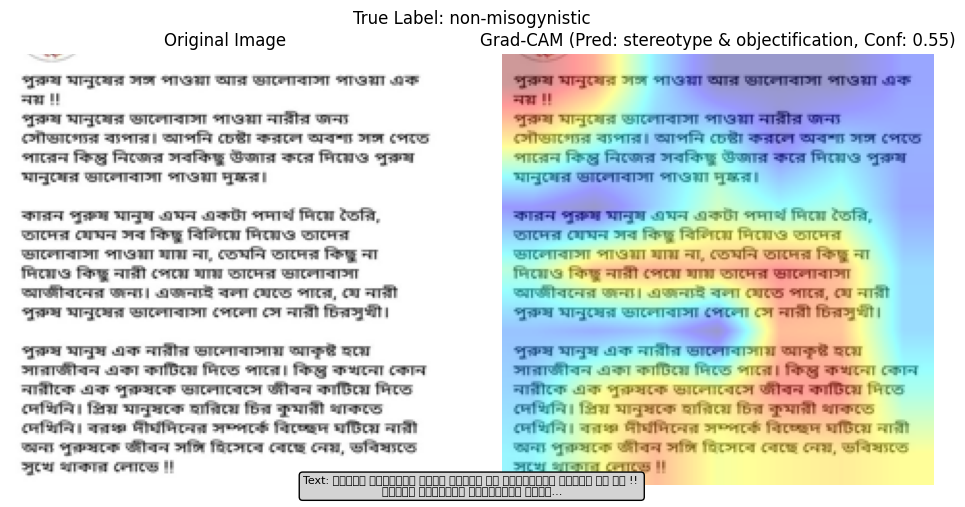

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:10, 10.49s/it]               


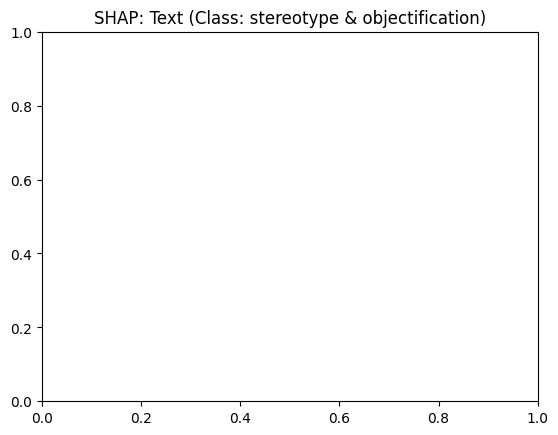


📘 Misclassified Sample 14 | True Label: violence or abuse | Predicted: non-misogynistic (0.58)


Glyph 2441 (\N{BENGALI LETTER U}) missing from current font.


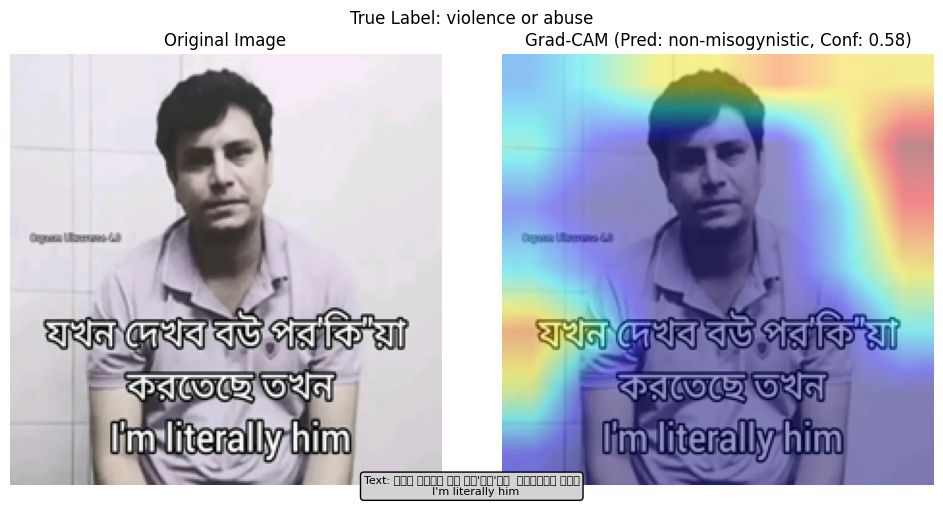

  0%|          | 0/342 [00:00<?, ?it/s]

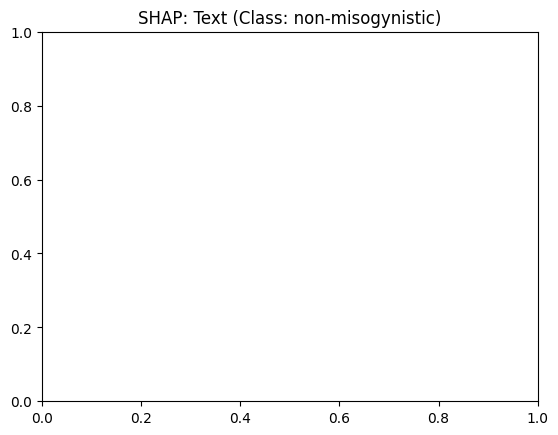


📘 Misclassified Sample 15 | True Label: non-misogynistic | Predicted: stereotype & objectification (0.75)


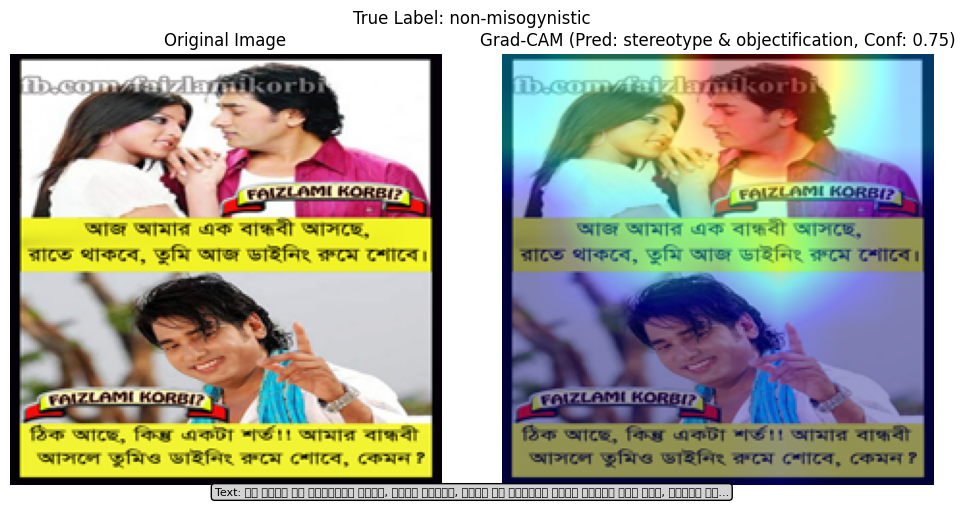

  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:10, 10.01s/it]               


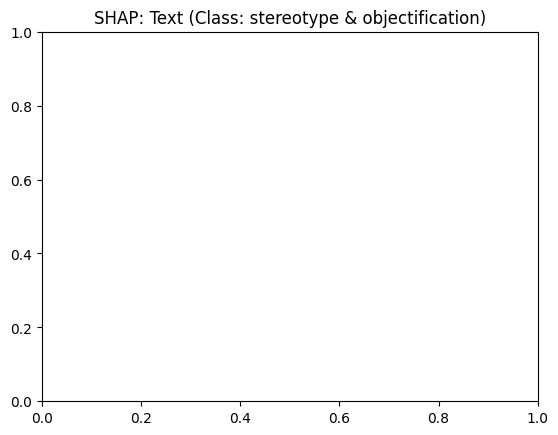

In [ ]:
import os
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from PIL import Image
from transformers import AutoModel, AutoTokenizer
import timm
import matplotlib.pyplot as plt
import numpy as np
import cv2
import shap
import joblib
from sklearn.metrics import classification_report, confusion_matrix
from tqdm.notebook import tqdm

# Device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using:", device)



# ======================= DATASET =========================
class MemeDataset(Dataset):
    def __init__(self, dataframe, img_dir, tokenizer, transform):
        self.data = dataframe
        self.img_dir = img_dir
        self.tokenizer = tokenizer
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        row = self.data.iloc[idx]
        image_path = os.path.join(self.img_dir, row["image"])
        image = self.transform(Image.open(image_path).convert("RGB"))
        text = row["text"]
        label = label2idx[row["label"]]

        encoding = self.tokenizer(text, padding="max_length", truncation=True, max_length=64, return_tensors="pt")
        return {
            "image": image,
            "input_ids": encoding["input_ids"].squeeze(0),
            "attention_mask": encoding["attention_mask"].squeeze(0),
            "label": torch.tensor(label)
        }

# ======================= MODEL =========================
class MultiModalModel(nn.Module):
    def __init__(self, text_model_name="csebuetnlp/banglabert", image_model_name="efficientnet_b0", num_classes=3):
        super().__init__()
        self.text_encoder = AutoModel.from_pretrained(text_model_name)
        self.text_proj = nn.Linear(self.text_encoder.config.hidden_size, 256)
        self.image_encoder = timm.create_model(image_model_name, pretrained=True, num_classes=0)
        self.image_proj = nn.Linear(self.image_encoder.num_features, 128)
        self.fusion = nn.Sequential(
            nn.Linear(256 + 128, 256),
            nn.ReLU(),
            nn.Dropout(0.3)
        )
        self.text_head = nn.Linear(256, num_classes)
        self.image_head = nn.Linear(128, num_classes)
        self.fusion_head = nn.Linear(256, num_classes)
        self.final_fusion = nn.Linear(num_classes * 3, num_classes)

    def forward(self, input_ids, attention_mask, image):
        text_outputs = self.text_encoder(input_ids=input_ids, attention_mask=attention_mask)
        text_global = text_outputs.last_hidden_state[:, 0]
        text_embed = self.text_proj(text_global)
        image_global = self.image_encoder(image)
        image_embed = self.image_proj(image_global)
        combined = torch.cat([text_embed, image_embed], dim=1)
        fused = self.fusion(combined)
        text_logits = self.text_head(text_embed)
        image_logits = self.image_head(image_embed)
        fusion_logits = self.fusion_head(fused)
        combined_logits = torch.cat([text_logits, image_logits, fusion_logits], dim=1)
        final_logits = self.final_fusion(combined_logits)
        return text_logits, image_logits, fusion_logits, final_logits

# Load saved model and metadata
model_path = "/kaggle/working/saved_models/multimodal_model_for_xai.pth"
checkpoint = torch.load(model_path, map_location=device, weights_only=False)
label_encoder = joblib.load("/kaggle/working/saved_models/label_encoder.pkl")
tokenizer_config = joblib.load("/kaggle/working/saved_models/tokenizer_config.pkl")
transform_config = joblib.load("/kaggle/working/saved_models/transform_config.pkl")

tokenizer = AutoTokenizer.from_pretrained(tokenizer_config['model_name'])
transform = transforms.Compose([
    transforms.Resize(transform_config['resize']),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

model = MultiModalModel().to(device)
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

# Load dataset
csv_path = "/kaggle/input/less-data/changed_ds/new_ds_small.csv"
img_dir = "/kaggle/input/less-data/changed_ds/img/"
df = pd.read_csv(csv_path)
df = df.rename(columns={"Unnamed: 0": "image"})
df = df[df['label'].isin(label2idx.keys())]

dataset = MemeDataset(df, img_dir, tokenizer, transform)
test_size = int(0.2 * len(dataset))
train_val_size = len(dataset) - test_size
train_val_ds, test_ds = random_split(dataset, [train_val_size, test_size])
test_loader = DataLoader(test_ds, batch_size=16, shuffle=False)

# ======================= FIND MISCLASSIFIED SAMPLES (First 15 in dataset order) =========================
def find_misclassified_samples(model, test_loader, dataset, num_samples=10):
    """
    Find misclassified samples from the test set
    """
    model.eval()
    misclassified = []

    with torch.no_grad():
        batch_idx = 0
        for batch in test_loader:
            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)
            image = batch["image"].to(device)
            labels = batch["label"].to(device)

            # Get predictions
            text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, image)
            predictions = torch.argmax(final_logits, dim=1)

            # Get probabilities for confidence scores
            probs = torch.softmax(final_logits, dim=1)
            confidence_scores = torch.max(probs, dim=1)[0]

            # Find misclassified samples in this batch
            for i in range(len(predictions)):
                if predictions[i] != labels[i]:
                    # Stop if we have enough samples
                    if len(misclassified) >= num_samples:
                        return misclassified

                    # Calculate actual index in original dataset
                    actual_idx = batch_idx * test_loader.batch_size + i

                    # Get original data
                    original_data = dataset.data.iloc[test_loader.dataset.indices[actual_idx]]

                    misclassified.append({
                        'index': actual_idx,
                        'image_path': original_data['image'],
                        'text': original_data['text'],
                        'true_label': idx2label[labels[i].item()],
                        'predicted_label': idx2label[predictions[i].item()],
                        'confidence': confidence_scores[i].item(),
                        'true_label_idx': labels[i].item(),
                        'predicted_label_idx': predictions[i].item()
                    })

            batch_idx += 1

    # Remove this sorting line to get first 15 in dataset order
    # misclassified.sort(key=lambda x: x['confidence'])

    return misclassified[:num_samples]

# ======================= GRAD-CAM =========================
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        self.hook_handles = []
        self._register_hooks()

    def _register_hooks(self):
        def forward_hook(module, input, output):
            self.activations = output

        def backward_hook(module, grad_in, grad_out):
            self.gradients = grad_out[0]

        self.hook_handles.append(self.target_layer.register_forward_hook(forward_hook))
        self.hook_handles.append(self.target_layer.register_full_backward_hook(backward_hook))

    def __call__(self, input_ids, attention_mask, image, class_idx):
        self.model.zero_grad()
        text_logits, image_logits, fusion_logits, final_logits = self.model(input_ids, attention_mask, image)
        target = final_logits[:, class_idx]
        target.backward()

        gradients = self.gradients.detach().cpu().numpy()
        activations = self.activations.detach().cpu().numpy()
        weights = np.mean(gradients, axis=(2, 3))
        cam = np.zeros(activations.shape[2:], dtype=np.float32)

        for i, w in enumerate(weights[0]):
            cam += w * activations[0, i]

        cam = np.maximum(cam, 0)
        cam = cv2.resize(cam, (224, 224))
        cam = cam - np.min(cam)
        cam = cam / (np.max(cam) + 1e-8)
        return cam

    def __del__(self):
        for handle in self.hook_handles:
            handle.remove()

# ======================= SHAP for TEXT =========================
def predict_shap(texts, class_idx):
    probs = []
    for text in texts:
        input_ids = tokenizer(text, return_tensors="pt", truncation=True, padding="max_length", max_length=64)["input_ids"].to(device)
        attention_mask = tokenizer(text, return_tensors="pt", truncation=True, padding="max_length", max_length=64)["attention_mask"].to(device)
        dummy_image = torch.zeros((1, 3, 224, 224)).to(device)

        with torch.no_grad():
            text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, dummy_image)
            prob = F.softmax(final_logits, dim=1)[0, class_idx].item()
        probs.append(prob)
    return np.array(probs)

# ======================= VISUALIZE XAI =========================
def visualize_xai(sample, img_dir, max_text_length=80):
    img_path = os.path.join(img_dir, sample['image_path'])
    text = sample['text']
    true_label = sample['true_label']
    pred_label = sample['predicted_label']
    pred_idx = sample['predicted_label_idx']
    confidence = sample['confidence']

    # Prepare inputs
    inputs = tokenizer(text, return_tensors="pt", truncation=True, padding="max_length", max_length=64)
    input_ids = inputs["input_ids"].to(device)
    attention_mask = inputs["attention_mask"].to(device)
    image = transform(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device)

    # Grad-CAM
    target_layer = model.image_encoder.conv_head
    gradcam = GradCAM(model, target_layer)
    cam = gradcam(input_ids, attention_mask, image, pred_idx)

    # Visualize Grad-CAM
    img_pil = Image.open(img_path).convert("RGB").resize((224, 224))
    img_np = np.array(img_pil, dtype=np.uint8)  # Ensure uint8
    img_np = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)  # Convert RGB to BGR
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)  # 3-channel BGR heatmap
    overlay = cv2.addWeighted(img_np, 0.6, heatmap, 0.4, 0)  # Both inputs are uint8, BGR, (224, 224, 3)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    ax1.imshow(cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB))  # Convert back to RGB for display
    ax1.set_title("Original Image")
    ax1.axis("off")
    ax2.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))  # Convert back to RGB for display
    ax2.set_title(f"Grad-CAM (Pred: {pred_label}, Conf: {confidence:.2f})")
    ax2.axis("off")
    plt.suptitle(f"True Label: {true_label}")
    plt.tight_layout()

    # Truncate text for display
    display_text = text if len(text) <= max_text_length else text[:max_text_length] + "..."
    plt.figtext(0.5, 0.01, f"Text: {display_text}", ha="center", fontsize=8, bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgray"))
    plt.show()

    # SHAP for text
    masker = shap.maskers.Text(tokenizer)
    explainer = shap.Explainer(lambda x: predict_shap(x, pred_idx), masker)
    shap_vals = explainer([text])
    shap.plots.text(shap_vals[0])
    plt.title(f"SHAP: Text (Class: {pred_label})")
    plt.show()

# ======================= RUN XAI FOR MISCLASSIFIED SAMPLES =========================
print("Finding 10 misclassified samples...")
misclassified_samples = find_misclassified_samples(model, test_loader, dataset, num_samples=15)

# Analyze patterns
print("\nAnalyzing misclassified samples...")
df_misclassified = pd.DataFrame(misclassified_samples)
print("=" * 50)
print("MISCLASSIFIED SAMPLES ANALYSIS")
print("=" * 50)
print(f"Total misclassified samples: {len(df_misclassified)}")
print(f"Average confidence: {df_misclassified['confidence'].mean():.3f}")
print(f"Confidence range: {df_misclassified['confidence'].min():.3f} - {df_misclassified['confidence'].max():.3f}")
print("\nConfusion Patterns:")
confusion_counts = df_misclassified.groupby(['true_label', 'predicted_label']).size()
for (true_label, pred_label), count in confusion_counts.items():
    print(f"  {true_label} -> {pred_label}: {count} samples")
df_misclassified['text_length'] = df_misclassified['text'].str.len()
print(f"\nText Length Analysis:")
print(f"  Average text length: {df_misclassified['text_length'].mean():.1f} characters")
print(f"  Text length range: {df_misclassified['text_length'].min()} - {df_misclassified['text_length'].max()}")

# Run XAI on misclassified samples
print("\nRunning explainability analysis...")
for idx, sample in enumerate(misclassified_samples):
    print(f"\n📘 Misclassified Sample {idx+1} | True Label: {sample['true_label']} | Predicted: {sample['predicted_label']} ({sample['confidence']:.2f})")
    visualize_xai(sample, img_dir)

In [ ]:

import os
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from PIL import Image
from transformers import AutoModel, AutoTokenizer
import timm
import matplotlib.pyplot as plt
import numpy as np
import cv2
import shap
import joblib
from sklearn.metrics import classification_report, confusion_matrix
from tqdm.notebook import tqdm

# Device configuration
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using:", device)

# Label mapping
label2idx = {"negative": 0, "neutral": 1, "positive": 2}
idx2label = {v: k for k, v in label2idx.items()}

# ======================= DATASET =========================
class MemeDataset(Dataset):
    def __init__(self, dataframe, img_dir, tokenizer, transform):
        self.data = dataframe
        self.img_dir = img_dir
        self.tokenizer = tokenizer
        self.transform = transform

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        row = self.data.iloc[idx]
        image_path = os.path.join(self.img_dir, row["image"])
        image = self.transform(Image.open(image_path).convert("RGB"))
        text = row["text"]
        label = label2idx[row["label"]]

        encoding = self.tokenizer(text, padding="max_length", truncation=True, max_length=64, return_tensors="pt")
        return {
            "image": image,
            "input_ids": encoding["input_ids"].squeeze(0),
            "attention_mask": encoding["attention_mask"].squeeze(0),
            "label": torch.tensor(label)
        }

# ======================= MODEL =========================
class MultiModalModel(nn.Module):
    def __init__(self, text_model_name="csebuetnlp/banglabert", image_model_name="efficientnet_b0", num_classes=3):
        super().__init__()
        self.text_encoder = AutoModel.from_pretrained(text_model_name)
        self.text_proj = nn.Linear(self.text_encoder.config.hidden_size, 256)
        self.image_encoder = timm.create_model(image_model_name, pretrained=True, num_classes=0)
        self.image_proj = nn.Linear(self.image_encoder.num_features, 128)
        self.fusion = nn.Sequential(
            nn.Linear(256 + 128, 256),
            nn.ReLU(),
            nn.Dropout(0.3)
        )
        self.text_head = nn.Linear(256, num_classes)
        self.image_head = nn.Linear(128, num_classes)
        self.fusion_head = nn.Linear(256, num_classes)
        self.final_fusion = nn.Linear(num_classes * 3, num_classes)

    def forward(self, input_ids, attention_mask, image):
        text_outputs = self.text_encoder(input_ids=input_ids, attention_mask=attention_mask)
        text_global = text_outputs.last_hidden_state[:, 0]
        text_embed = self.text_proj(text_global)
        image_global = self.image_encoder(image)
        image_embed = self.image_proj(image_global)
        combined = torch.cat([text_embed, image_embed], dim=1)
        fused = self.fusion(combined)
        text_logits = self.text_head(text_embed)
        image_logits = self.image_head(image_embed)
        fusion_logits = self.fusion_head(fused)
        combined_logits = torch.cat([text_logits, image_logits, fusion_logits], dim=1)
        final_logits = self.final_fusion(combined_logits)
        return text_logits, image_logits, fusion_logits, final_logits

# Load saved model and metadata
model_path = "/kaggle/working/saved_models/multimodal_model_for_xai.pth"
checkpoint = torch.load(model_path, map_location=device, weights_only=False)
label_encoder = joblib.load("/kaggle/working/saved_models/label_encoder.pkl")
tokenizer_config = joblib.load("/kaggle/working/saved_models/tokenizer_config.pkl")
transform_config = joblib.load("/kaggle/working/saved_models/transform_config.pkl")

tokenizer = AutoTokenizer.from_pretrained(tokenizer_config['model_name'])
transform = transforms.Compose([
    transforms.Resize(transform_config['resize']),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

model = MultiModalModel().to(device)
model.load_state_dict(checkpoint['model_state_dict'])
model.eval()

# Load dataset
csv_path = "/kaggle/input/less-data/changed_ds/new_ds_small.csv"
img_dir = "/kaggle/input/less-data/changed_ds/img/"
df = pd.read_csv(csv_path)
df = df.rename(columns={"Unnamed: 0": "image"})
df = df[df['label'].isin(label2idx.keys())]

dataset = MemeDataset(df, img_dir, tokenizer, transform)
test_size = int(0.2 * len(dataset))
train_val_size = len(dataset) - test_size
train_val_ds, test_ds = random_split(dataset, [train_val_size, test_size])
test_loader = DataLoader(test_ds, batch_size=16, shuffle=False)

# ======================= FIND MISCLASSIFIED SAMPLES =========================
def find_misclassified_samples(model, test_loader, dataset, specific_image_paths=None, num_samples=100):
    """
    Find misclassified samples from the test set, optionally filtering by specific image paths
    """
    model.eval()
    misclassified = []

    with torch.no_grad():
        batch_idx = 0
        for batch in tqdm(test_loader, desc="Finding misclassified samples"):
            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)
            image = batch["image"].to(device)
            labels = batch["label"].to(device)

            # Get predictions
            text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, image)
            predictions = torch.argmax(final_logits, dim=1)

            # Get probabilities for confidence scores
            probs = torch.softmax(final_logits, dim=1)
            confidence_scores = torch.max(probs, dim=1)[0]

            # Find misclassified samples in this batch
            for i in range(len(predictions)):
                if predictions[i] != labels[i]:
                    # Calculate actual index in original dataset
                    actual_idx = test_loader.dataset.indices[batch_idx * test_loader.batch_size + i]

                    # Get original data
                    original_data = dataset.data.iloc[actual_idx]
                    image_path = original_data['image']

                    # Skip if specific_image_paths is provided and image_path is not in it
                    if specific_image_paths is not None and image_path not in specific_image_paths:
                        continue

                    misclassified.append({
                        'index': actual_idx,
                        'image_path': image_path,
                        'text': original_data['text'],
                        'true_label': idx2label[labels[i].item()],
                        'predicted_label': idx2label[predictions[i].item()],
                        'confidence': confidence_scores[i].item(),
                        'true_label_idx': labels[i].item(),
                        'predicted_label_idx': predictions[i].item()
                    })

            batch_idx += 1

    # If specific_image_paths is provided, ensure only those are returned
    if specific_image_paths is not None:
        misclassified = [sample for sample in misclassified if sample['image_path'] in specific_image_paths]
    else:
        # Otherwise, limit to num_samples
        misclassified = misclassified[:num_samples]

    return misclassified

# ======================= GRAD-CAM =========================
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        self.hook_handles = []
        self._register_hooks()

    def _register_hooks(self):
        def forward_hook(module, input, output):
            self.activations = output

        def backward_hook(module, grad_in, grad_out):
            self.gradients = grad_out[0]

        self.hook_handles.append(self.target_layer.register_forward_hook(forward_hook))
        self.hook_handles.append(self.target_layer.register_full_backward_hook(backward_hook))

    def __call__(self, input_ids, attention_mask, image, class_idx):
        self.model.zero_grad()
        text_logits, image_logits, fusion_logits, final_logits = self.model(input_ids, attention_mask, image)
        target = final_logits[:, class_idx]
        target.backward()

        gradients = self.gradients.detach().cpu().numpy()
        activations = self.activations.detach().cpu().numpy()
        weights = np.mean(gradients, axis=(2, 3))
        cam = np.zeros(activations.shape[2:], dtype=np.float32)

        for i, w in enumerate(weights[0]):
            cam += w * activations[0, i]

        cam = np.maximum(cam, 0)
        cam = cv2.resize(cam, (224, 224))
        cam = cam - np.min(cam)
        cam = cam / (np.max(cam) + 1e-8)
        return cam

    def __del__(self):
        for handle in self.hook_handles:
            handle.remove()

# ======================= SHAP for TEXT =========================
def predict_shap(texts, class_idx):
    probs = []
    for text in texts:
        input_ids = tokenizer(text, return_tensors="pt", truncation=True, padding="max_length", max_length=64)["input_ids"].to(device)
        attention_mask = tokenizer(text, return_tensors="pt", truncation=True, padding="max_length", max_length=64)["attention_mask"].to(device)
        dummy_image = torch.zeros((1, 3, 224, 224)).to(device)

        with torch.no_grad():
            text_logits, image_logits, fusion_logits, final_logits = model(input_ids, attention_mask, dummy_image)
            prob = F.softmax(final_logits, dim=1)[0, class_idx].item()
        probs.append(prob)
    return np.array(probs)

# ======================= VISUALIZE XAI =========================
def visualize_xai(sample, img_dir, max_text_length=80):
    img_path = os.path.join(img_dir, sample['image_path'])
    text = sample['text']
    true_label = sample['true_label']
    pred_label = sample['predicted_label']
    pred_idx = sample['predicted_label_idx']
    confidence = sample['confidence']

    # Prepare inputs
    inputs = tokenizer(text, return_tensors="pt", truncation=True, padding="max_length", max_length=64)
    input_ids = inputs["input_ids"].to(device)
    attention_mask = inputs["attention_mask"].to(device)
    image = transform(Image.open(img_path).convert("RGB")).unsqueeze(0).to(device)

    # Grad-CAM
    target_layer = model.image_encoder.conv_head
    gradcam = GradCAM(model, target_layer)
    cam = gradcam(input_ids, attention_mask, image, pred_idx)

    # Visualize Grad-CAM
    img_pil = Image.open(img_path).convert("RGB").resize((224, 224))
    img_np = np.array(img_pil, dtype=np.uint8)  # Ensure uint8
    img_np = cv2.cvtColor(img_np, cv2.COLOR_RGB2BGR)  # Convert RGB to BGR
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)  # 3-channel BGR heatmap
    overlay = cv2.addWeighted(img_np, 0.6, heatmap, 0.4, 0)  # Both inputs are uint8, BGR, (224, 224, 3)

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))
    ax1.imshow(cv2.cvtColor(img_np, cv2.COLOR_BGR2RGB))  # Convert back to RGB for display
    ax1.set_title("Original Image")
    ax1.axis("off")
    ax2.imshow(cv2.cvtColor(overlay, cv2.COLOR_BGR2RGB))  # Convert back to RGB for display
    ax2.set_title(f"Grad-CAM (Pred: {pred_label}, Conf: {confidence:.2f})")
    ax2.axis("off")
    plt.suptitle(f"True Label: {true_label}")
    plt.tight_layout()

    # Truncate text for display
    display_text = text if len(text) <= max_text_length else text[:max_text_length] + "..."
    plt.figtext(0.5, 0.01, f"Text: {display_text}", ha="center", fontsize=8, bbox=dict(boxstyle="round,pad=0.3", facecolor="lightgray"))
    plt.show()

    # SHAP for text
    masker = shap.maskers.Text(tokenizer)
    explainer = shap.Explainer(lambda x: predict_shap(x, pred_idx), masker)
    shap_vals = explainer([text])
    shap.plots.text(shap_vals[0])
    plt.title(f"SHAP: Text (Class: {pred_label})")
    plt.show()

# ======================= RUN XAI FOR SPECIFIC MISCLASSIFIED SAMPLES =========================
# Specify the image paths to analyze (filenames from the 'image' column in the CSV)
specific_image_paths = ["0.jpg", "4.jpg", "10.jpg", "511.jpg"]  # Replace with your image filenames

print(f"Finding misclassified samples for image paths: {specific_image_paths}")
misclassified_samples = find_misclassified_samples(model, test_loader, dataset, specific_image_paths=specific_image_paths)

# Analyze patterns
if misclassified_samples:
    print("\nAnalyzing misclassified samples...")
    df_misclassified = pd.DataFrame(misclassified_samples)
    print("=" * 50)
    print("MISCLASSIFIED SAMPLES ANALYSIS")
    print("=" * 50)
    print(f"Total misclassified samples: {len(df_misclassified)}")
    print(f"Average confidence: {df_misclassified['confidence'].mean():.3f}")
    print(f"Confidence range: {df_misclassified['confidence'].min():.3f} - {df_misclassified['confidence'].max():.3f}")
    print("\nConfusion Patterns:")
    confusion_counts = df_misclassified.groupby(['true_label', 'predicted_label']).size()
    for (true_label, pred_label), count in confusion_counts.items():
        print(f"  {true_label} -> {pred_label}: {count} samples")
    df_misclassified['text_length'] = df_misclassified['text'].str.len()
    print(f"\nText Length Analysis:")
    print(f"  Average text length: {df_misclassified['text_length'].mean():.1f} characters")
    print(f"  Text length range: {df_misclassified['text_length'].min()} - {df_misclassified['text_length'].max()}")
else:
    print("No misclassified samples found for the specified image paths.")

# Run XAI on misclassified samples
if misclassified_samples:
    print("\nRunning explainability analysis...")
    for idx, sample in enumerate(misclassified_samples):
        print(f"\n📘 Misclassified Sample {idx+1} (Image: {sample['image_path']}, Index: {sample['index']}) | True Label: {sample['true_label']} | Predicted: {sample['predicted_label']} ({sample['confidence']:.2f})")
        visualize_xai(sample, img_dir)

Using: cuda
Finding misclassified samples for image paths: ['0.jpg', '4.jpg', '10.jpg', '511.jpg']


Finding misclassified samples: 0it [00:00, ?it/s]

No misclassified samples found for the specified image paths.
